# packages import

In [1]:
import gc
import warnings
from typing import Dict, Tuple, List
from collections import Counter, defaultdict
from datetime import date, datetime, timedelta

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import seaborn as sns
import lightgbm as lgb
import xgboost as xgb
import catboost as cb
import optuna
import mlflow
from sklearn.metrics import mean_squared_error, roc_auc_score, roc_curve, auc
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, GroupKFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, LabelEncoder
from tqdm import tqdm_notebook as tqdm
#from IPython.display import display # Allows the use of display() for DataFrames
from IPython.core.display import display, HTML
from pylab import rcParams

# ①日本語を表示するためのフォントの指定
# print([f.name for f in fm.fontManager.ttflist])
# ②日本語フォントがない場合
# print(matplotlib.matplotlib_fname())
# ③上記で表示されたフォルダのパスの途中(.../mpl-data/fonts/ttf)に.ttfを格納し、下記を実行
# print(matplotlib.get_cachedir())
# ④上記フォルダ内の"fontlist~.json"を削除して下記でリビルド
# matplotlib.font_manager._rebuild()
# ⑤フォントの一覧に.ttfで追加したフォントが表示されるはず

In [2]:
%matplotlib inline
warnings.filterwarnings("ignore", category=DeprecationWarning)
display(HTML("<style>.container { width:80% !important; }</style>")) # 表示画面サイズ変更
rcParams["figure.figsize"] = (14, 6)
sns.set(context='notebook', style='whitegrid', font_scale=1.6, font=["IPAPGothic"], rc={"lines.linewidth": 2})
sns.set_palette(sns.color_palette(["#42A5F5", "#FFA726", "#66BB6A", "#AB47BC", "#EF5350", "#FFEE58", "#8D6E63", \
                                   "#78909C", "#26C6DA", "#26A69A", "#5C6BC0", "#FF80AB", "#C6FF00", "#BDBDBD"]))
pd.set_option('display.max_columns', 500)

C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [3]:
data_dir = None
if _dh == ["/kaggle/working"]:
    data_dir = "/kaggle/input/competition_name/"
else:
    data_dir = "data/"

# read data

In [4]:
# train_df = pd.read_csv(data_dir + "train_data.csv")
# test_df = pd.read_csv(data_dir + "test_data.csv")
# weapon_df = pd.read_csv(data_dir + "statink-weapon2.csv")
# all_df = pd.concat([train_df, test_df], axis=0).reset_index(drop=True)

#  merging

In [5]:
# # 追加データの"key"と"xx-weapon"はユニークで完全一致
# weapons = set()
# for team in ["A", "B"]:
#     for i in range(1, 5, 1):
#         weapons |= set(all_df[team + str(i) + "-weapon"])
# weapons = set(d for d in weapons if str(d) != 'nan')
# weapons == set(weapon_df["key"])

In [6]:
# # keyは武器の名前、mainweaponは武器の性能上での名前、reskinはreplica系を同一性能の武器の名前にしたもの
# weapon_df.columns

In [7]:
# weapon_df = weapon_df[["key", "category1", "category2", "mainweapon", "reskin", "subweapon", "special"]]

In [8]:
# all_df.columns

In [9]:
# weapons = pd.DataFrame()
# for team in ["A", "B"]:
#     for i in range(1, 5, 1):
#         orig = all_df[[team + str(i) + "-rank", team + str(i) + "-level", team + str(i) + "-weapon"]]
#         temp = weapon_df.copy()
#         temp = temp.rename(columns={
#             "key": team + str(i) + "-weapon", 
#             "category1": team + str(i) + "-category1",
#             "category2": team + str(i) + "-category2",
#             "mainweapon": team + str(i) + "-mainweapon",
#             "reskin": team + str(i) + "-reskin",
#             "subweapon": team + str(i) + "-subweapon",
#             "special": team + str(i) + "-special", 
#         })
#         weapons = pd.concat([weapons, orig.merge(temp, on=team + str(i) + "-weapon", how="left")], axis=1)

In [10]:
# weapons

In [11]:
# weapons.isnull().sum()

In [12]:
# # 一応チェック
# for team in ["A", "B"]:
#     for i in range(1, 5, 1):
#         assert (all_df[team + str(i) + "-weapon"] == weapons[team + str(i) + "-weapon"]).sum() == all_df[team + str(i) + "-weapon"].dropna().shape[0]

In [13]:
# all_df = pd.concat([all_df[["id", "period", "game-ver", "lobby-mode", "lobby", "mode", "stage", "y"]], weapons], axis=1)
# all_df = all_df[["id", "period", "game-ver", "lobby-mode", "lobby", "mode", "stage"] + weapons.columns.tolist() + ["y"]]
# all_df

In [14]:
# all_df.to_csv(data_dir + "train+test+weapons.csv", index=False)

# observation

In [15]:
all_df = pd.read_csv(data_dir + "train+test+weapons.csv")
all_df

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
0,1,2019-10-15T20:00:00+00:00,5.0.1,regular,standard,nawabari,sumeshi,NaN,139,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile,NaN,118.0,soytuber_custom,charger,charger,soytuber,soytuber_custom,curlingbomb,jetpack,NaN,13.0,pablo_hue,roller,brush,pablo,pablo_hue,trap,sphere,NaN,10.0,hokusai,roller,brush,hokusai,hokusai,robotbomb,jetpack,NaN,28,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,26.0,hokusai_becchu,roller,brush,hokusai,hokusai_becchu,kyubanbomb,ultrahanko,NaN,68.0,herocharger_replica,charger,charger,splatcharger,splatcharger,splashbomb,presser,NaN,31.0,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,1.0
1,2,2019-12-14T04:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,NaN,198,parashelter_sorella,brella,brella,parashelter,parashelter_sorella,robotbomb,splashbomb_pitcher,NaN,77.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,NaN,198.0,campingshelter_camo,brella,brella,campingshelter,campingshelter_camo,trap,ultrahanko,NaN,123.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,NaN,83,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,NaN,118.0,squiclean_b,charger,charger,squiclean_a,squiclean_b,robotbomb,sphere,NaN,168.0,campingshelter,brella,brella,campingshelter,campingshelter,jumpbeacon,bubble,NaN,151.0,sputtery_clear,shooter,maneuver,sputtery,sputtery_clear,torpedo,chakuchi,0.0
2,3,2019-12-25T14:00:00+00:00,5.0.1,gachi,standard,hoko,ama,a-,114,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,a,68.0,quadhopper_black,shooter,maneuver,quadhopper_black,quadhopper_black,robotbomb,chakuchi,a,225.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,107.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,a-,50,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,a+,163.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,a-,160.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,126.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,0.0
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,NaN,336,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,131.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,189.0,dynamo_tesla,roller,roller,dynamo,dynamo_tesla,splashbomb,armor,NaN,41.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,273,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,189.0,liter4k,charger,charger,liter4k,liter4k,trap,amefurashi,NaN,194.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,391.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,0.0
4,5,2019-12-14T06:00:00+00:00,5.0.1,gachi,standard,hoko,chozame,x,299,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,x,97.0,hissen_hue,slosher,slosher,hissen,hissen_hue,splashbomb,amefurashi,x,96.0,h3reelgun_d,shooter,reelgun,h3reelgun,h3reelgun_d,kyubanbomb,armor,x,136.0,splatroller,roller,roller,spl

In [16]:
train_df = all_df.dropna(subset=["y"])
test_df = all_df[all_df["y"].isnull()]
del all_df
gc.collect()

24

In [56]:
len(set(map(tuple, train_df.iloc[:, 1:-1].values)))

66104

In [57]:
temp = set(map(tuple, train_df.iloc[:, 1:-1].values)) & set(map(tuple, test_df.iloc[:, 1:-1].values))
len(temp)

17

In [96]:
train_df["A1-rank"] = train_df["A1-rank"].replace(np.nan, "NaN")

C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [99]:
train_df["A1-player"] = train_df["A1-rank"] + "_" + train_df["A1-level"].astype(str) + "_" + train_df["A1-weapon"] + "_" + train_df["A1-category1"] \
                        + "_" + train_df["A1-category2"] + "_" + train_df["A1-mainweapon"] + "_" + train_df["A1-reskin"] \
                        + "_" + train_df["A1-subweapon"] + "_" + train_df["A1-special"]
train_df

C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,A1-player
0,1,2019-10-15T20:00:00+00:00,5.0.1,regular,standard,nawabari,sumeshi,NaN,139,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile,NaN,118.0,soytuber_custom,charger,charger,soytuber,soytuber_custom,curlingbomb,jetpack,NaN,13.0,pablo_hue,roller,brush,pablo,pablo_hue,trap,sphere,NaN,10.0,hokusai,roller,brush,hokusai,hokusai,robotbomb,jetpack,NaN,28,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,26.0,hokusai_becchu,roller,brush,hokusai,hokusai_becchu,kyubanbomb,ultrahanko,NaN,68.0,herocharger_replica,charger,charger,splatcharger,splatcharger,splashbomb,presser,NaN,31.0,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,1.0,NaN_139_sshooter_becchu_shooter_shooter_sshoot...
1,2,2019-12-14T04:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,NaN,198,parashelter_sorella,brella,brella,parashelter,parashelter_sorella,robotbomb,splashbomb_pitcher,NaN,77.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,NaN,198.0,campingshelter_camo,brella,brella,campingshelter,campingshelter_camo,trap,ultrahanko,NaN,123.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,NaN,83,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,NaN,118.0,squiclean_b,charger,charger,squiclean_a,squiclean_b,robotbomb,sphere,NaN,168.0,campingshelter,brella,brella,campingshelter,campingshelter,jumpbeacon,bubble,NaN,151.0,sputtery_clear,shooter,maneuver,sputtery,sputtery_clear,torpedo,chakuchi,0.0,NaN_198_parashelter_sorella_brella_brella_para...
2,3,2019-12-25T14:00:00+00:00,5.0.1,gachi,standard,hoko,ama,a-,114,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,a,68.0,quadhopper_black,shooter,maneuver,quadhopper_black,quadhopper_black,robotbomb,chakuchi,a,225.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,107.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,a-,50,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,a+,163.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,a-,160.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,126.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,0.0,a-_114_nzap89_shooter_shooter_nzap85_nzap89_ro...
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,NaN,336,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,131.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,189.0,dynamo_tesla,roller,roller,dynamo,dynamo_tesla,splashbomb,armor,NaN,41.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,273,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,189.0,liter4k,charger,charger,liter4k,liter4k,trap,amefurashi,NaN,194.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,391.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,0.0,NaN_336_bamboo14mk1_charger_charger_bamboo14mk...
4,5,2019-12-14T06:00:00+00:00,5.0.1,gachi,standard,hoko,chozame,x,299,bold_7,shooter,shooter,bold,bold

In [101]:
test_df["A1-player"] = test_df["A1-rank"] + "_" + test_df["A1-level"].astype(str) + "_" + test_df["A1-weapon"] + "_" + test_df["A1-category1"] \
                        + "_" + test_df["A1-category2"] + "_" + test_df["A1-mainweapon"] + "_" + test_df["A1-reskin"] \
                        + "_" + test_df["A1-subweapon"] + "_" + test_df["A1-special"]
test_df

C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,A1-player
66125,1,2019-12-17T12:00:00+00:00,5.0.1,gachi,standard,area,hakofugu,x,174,prime_collabo,shooter,shooter,prime,prime_collabo,kyubanbomb,bubble,x,130.0,herospinner_replica,splatling,splatling,barrelspinner,barrelspinner,sprinkler,presser,x,127.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,x,233.0,nova_becchu,shooter,blaster,nova,nova_becchu,tansanbomb,amefurashi,x,160,furo,slosher,slosher,furo,furo,splashshield,amefurashi,x,151.0,nautilus47,splatling,splatling,nautilus47,nautilus47,pointsensor,sphere,x,213.0,l3reelgun_d,shooter,reelgun,l3reelgun,l3reelgun_d,quickbomb,jetpack,x,306.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,x_174_prime_collabo_shooter_shooter_prime_prim...
66126,2,2019-11-25T16:00:00+00:00,5.0.1,gachi,standard,asari,anchovy,s+,363,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,s+,59.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,s+,36.0,dynamo_becchu,roller,roller,dynamo,dynamo_becchu,sprinkler,nicedama,s+,225.0,rapid_becchu,shooter,blaster,rapid,rapid_becchu,torpedo,sphere,s+,326,furo,slosher,slosher,furo,furo,splashshield,amefurashi,s+,289.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,s+,147.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,s+,156.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,NaN,s+_363_prime_becchu_shooter_shooter_prime_prim...
66127,3,2019-10-22T08:00:00+00:00,5.0.1,gachi,standard,area,mutsugoro,s,116,furo_deco,slosher,slosher,furo,furo_deco,sprinkler,kyubanbomb_pitcher,s,125.0,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,s,124.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,s,181.0,wakaba,shooter,shooter,wakaba,wakaba,splashbomb,armor,s,76,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,s,232.0,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,s,183.0,nzap83,shooter,shooter,nzap85,nzap83,sprinkler,amefurashi,s,105.0,promodeler_pg,shooter,shooter,promodeler_mg,promodeler_pg,quickbomb,nicedama,NaN,s_116_furo_deco_slosher_slosher_furo_furo_deco...
66128,4,2019-12-30T04:00:00+00:00,5.0.1,gachi,standard,asari,devon,s+,192,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,s+,115.0,splatspinner_collabo,splatling,splatling,splatspinner,splatspinner_collabo,curlingbomb,amefurashi,s+,171.0,pablo,roller,brush,pablo,pablo,splashbomb,chakuchi,s+,170.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,s+,90,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,s+,119.0,quadhopper_black,shooter,maneuver,quadhopper_black,quadhopper_black,robotbomb,chakuchi,s+,172.0,soytuber,charger,charger,soytuber,soytuber,kyubanbomb,chakuchi,s+,70.0,prime,shooter,shooter,prime,prime,pointsensor,amefurashi,NaN,s+_192_prime_becchu_shooter_shooter_prime_prim...
66129,5,2019-10-15T16:00:00+00:00,5.0.1,gachi,standard,yagura,anchovy,x,267,l3reelgun_d,shooter,reelgun,l3reelgun,l3reelgun_d,quickbomb,jetpack,x,223.0,rapid_becchu,shooter,blaster,rapid,rapid_becchu,torpedo,sphere,x,240.0,heroroller_replica,roller,roller,splatr

In [102]:
train_df["A1-player"].nunique(), test_df["A1-player"].nunique()

(8929, 4833)

In [110]:
len(list(set(train_df["A1-player"].tolist()) & set(test_df["A1-player"].tolist())))

4343

In [129]:
target_mean = train_df.groupby(["mode", "A1-player"])["y"].mean()
train_df["strength"] = train_df[["mode", "A1-player"]].map(target_mean)

AttributeError: 'DataFrame' object has no attribute 'map'

In [128]:
target_mean

mode    A1-player                                                                                                  
area    a+_101_wakaba_shooter_shooter_wakaba_wakaba_splashbomb_armor                                                   0.250000
        a+_103_nzap89_shooter_shooter_nzap85_nzap89_robotbomb_missile                                                  0.421053
        a+_106_nzap89_shooter_shooter_nzap85_nzap89_robotbomb_missile                                                  0.666667
        a+_106_sputtery_clear_shooter_maneuver_sputtery_sputtery_clear_torpedo_chakuchi                                0.333333
        a+_106_spygadget_becchu_brella_brella_spygadget_spygadget_becchu_torpedo_armor                                 0.400000
                                                                                                                         ...   
yagura  x_95_splatcharger_collabo_charger_charger_splatcharger_splatcharger_collabo_splashshield_kyubanbomb_pitcher 

In [122]:
train_df[train_df["strength"] < 0.1][train_df[train_df["strength"] < 0.1]["A1-player"].duplicated()]

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,A1-player,strength


In [123]:
train_df[train_df["A1-player"] == 'NaN_336_bamboo14mk1_charger_charger_bamboo14mk1_bamboo14mk1_curlingbomb_missile']


,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,A1-player,strength
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,NaN,336,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,131.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,189.0,dynamo_tesla,roller,roller,dynamo,dynamo_tesla,splashbomb,armor,NaN,41.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,273,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,189.0,liter4k,charger,charger,liter4k,liter4k,trap,amefurashi,NaN,194.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,391.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,0.0,NaN_336_bamboo14mk1_charger_charger_bamboo14mk...,NaN


<AxesSubplot:ylabel='Frequency'>

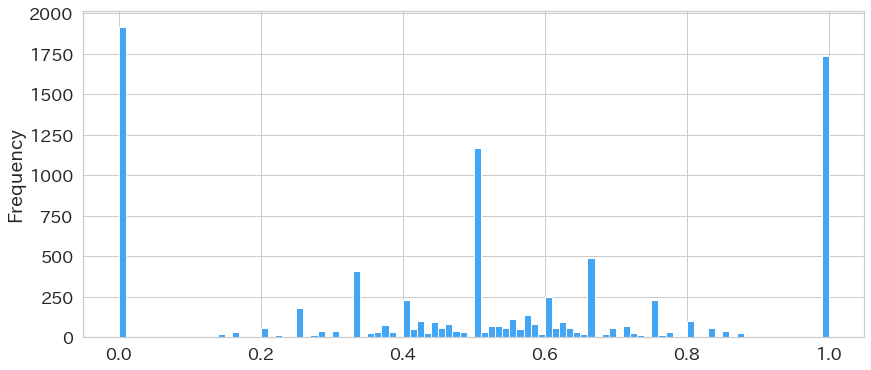

In [124]:
train_df.groupby("A1-player")["y"].mean().plot(kind="hist", bins=100)

In [127]:
train_df[train_df["lobby-mode"] == "regular"]

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,A1-player,strength
0,1,2019-10-15T20:00:00+00:00,5.0.1,regular,standard,nawabari,sumeshi,NaN,139,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile,NaN,118.0,soytuber_custom,charger,charger,soytuber,soytuber_custom,curlingbomb,jetpack,NaN,13.0,pablo_hue,roller,brush,pablo,pablo_hue,trap,sphere,NaN,10.0,hokusai,roller,brush,hokusai,hokusai,robotbomb,jetpack,NaN,28,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,26.0,hokusai_becchu,roller,brush,hokusai,hokusai_becchu,kyubanbomb,ultrahanko,NaN,68.0,herocharger_replica,charger,charger,splatcharger,splatcharger,splashbomb,presser,NaN,31.0,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,1.0,NaN_139_sshooter_becchu_shooter_shooter_sshoot...,NaN
1,2,2019-12-14T04:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,NaN,198,parashelter_sorella,brella,brella,parashelter,parashelter_sorella,robotbomb,splashbomb_pitcher,NaN,77.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,NaN,198.0,campingshelter_camo,brella,brella,campingshelter,campingshelter_camo,trap,ultrahanko,NaN,123.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,NaN,83,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,NaN,118.0,squiclean_b,charger,charger,squiclean_a,squiclean_b,robotbomb,sphere,NaN,168.0,campingshelter,brella,brella,campingshelter,campingshelter,jumpbeacon,bubble,NaN,151.0,sputtery_clear,shooter,maneuver,sputtery,sputtery_clear,torpedo,chakuchi,0.0,NaN_198_parashelter_sorella_brella_brella_para...,NaN
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,NaN,336,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,131.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,189.0,dynamo_tesla,roller,roller,dynamo,dynamo_tesla,splashbomb,armor,NaN,41.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,273,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,189.0,liter4k,charger,charger,liter4k,liter4k,trap,amefurashi,NaN,194.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,391.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,0.0,NaN_336_bamboo14mk1_charger_charger_bamboo14mk...,NaN
7,8,2019-12-31T06:00:00+00:00,5.0.1,regular,standard,nawabari,ama,NaN,113,octoshooter_replica,shooter,shooter,sshooter,sshooter_collabo,splashbomb,jetpack,NaN,7.0,bucketslosher,slosher,slosher,bucketslosher,bucketslosher,kyubanbomb,missile,NaN,12.0,carbon,roller,roller,carbon,carbon,robotbomb,amefurashi,NaN,19.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,NaN,8,maneuver,shooter,maneuver,maneuver,maneuver,quickbomb,missile,NaN,13.0,pablo_permanent,roller,brush,pablo,pablo_permanent,sprinkler,armor,NaN,38.0,dynamo_becchu,roller,roller,dynamo,dynamo_becchu,sprinkler,nicedama,NaN,32.0,splatscope_becchu,charger,charger,splatcharger,splatscope_becchu,sprinkler,sphere,1.0,NaN_113_octoshooter_replica_shooter_shooter_ss...,NaN
16,17,2019-11-02T12:00:00+00:00,5.0.1,regular,stand

In [87]:
temp = train_df[["A1-rank", "A1-level", "A1-weapon", "A1-category1", "A1-category2", "A1-mainweapon", "A1-reskin", "A1-subweapon", "A1-special"]]

In [93]:
temp[temp.duplicated()].sort_values(by=["A1-rank", "A1-level", "A1-weapon"]).head(50)

,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special
27220,a,22,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher
48165,a,22,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher
30497,a,24,furo,slosher,slosher,furo,furo,splashshield,amefurashi
25172,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
26267,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
28283,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
36995,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
48576,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
65819,a,24,sshooter_becchu,shooter,shooter,sshooter,sshooter_becchu,kyubanbomb,missile
4430,a,27,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile


In [92]:
train_df.iloc[[27220, 48165]]

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
27220,27221,2019-11-30T14:00:00+00:00,5.0.1,gachi,standard,hoko,anchovy,a,22,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher,a+,235.0,hydra_custom,splatling,splatling,hydra,hydra_custom,trap,armor,a-,21.0,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,a-,29.0,splatcharger,charger,charger,splatcharger,splatcharger,splashbomb,presser,a+,99,longblaster,shooter,blaster,longblaster,longblaster,kyubanbomb,amefurashi,a,17.0,splatcharger,charger,charger,splatcharger,splatcharger,splashbomb,presser,a+,21.0,parashelter,brella,brella,parashelter,parashelter,sprinkler,amefurashi,a+,33.0,bottlegeyser_foil,shooter,shooter,bottlegeyser,bottlegeyser_foil,splashbomb,bubble,0.0
48165,48166,2019-11-30T14:00:00+00:00,5.0.1,gachi,standard,hoko,kombu,a,22,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher,a+,75.0,nautilus79,splatling,splatling,nautilus47,nautilus79,kyubanbomb,jetpack,a+,87.0,splatcharger,charger,charger,splatcharger,splatcharger,splashbomb,presser,a+,68.0,wakaba,shooter,shooter,wakaba,wakaba,splashbomb,armor,a+,173,kugelschreiber_hue,splatling,splatling,kugelschreiber,kugelschreiber_hue,jumpbeacon,amefurashi,a,27.0,splatscope,charger,charger,splatcharger,splatscope,splashbomb,presser,a+,122.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,a+,341.0,sharp,shooter,shooter,sharp,sharp,poisonmist,jetpack,0.0


In [81]:
train_df[train_df["period"] == '2019-12-02T04:00:00+00:00']

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
3257,3258,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,ama,x,78,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,x,93.0,96gal,shooter,shooter,96gal,96gal,sprinkler,armor,x,198.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,x,149.0,pablo_hue,roller,brush,pablo,pablo_hue,trap,sphere,x,120,screwslosher_becchu,slosher,slosher,screwslosher,screwslosher_becchu,tansanbomb,chakuchi,x,150.0,dualsweeper,shooter,maneuver,dualsweeper,dualsweeper,pointsensor,missile,x,87.0,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,x,361.0,nautilus47,splatling,splatling,nautilus47,nautilus47,pointsensor,sphere,1.0
4130,4131,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,ama,x,78,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,x,140.0,l3reelgun,shooter,reelgun,l3reelgun,l3reelgun,curlingbomb,sphere,x,150.0,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,x,231.0,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,x,130,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,x,232.0,96gal,shooter,shooter,96gal,96gal,sprinkler,armor,x,161.0,pablo,roller,brush,pablo,pablo,splashbomb,chakuchi,x,348.0,splatscope_becchu,charger,charger,splatcharger,splatscope_becchu,sprinkler,sphere,1.0
7221,7222,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,ama,x,78,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,x,140.0,l3reelgun,shooter,reelgun,l3reelgun,l3reelgun,curlingbomb,sphere,x,150.0,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,x,231.0,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,x,130,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,x,232.0,96gal,shooter,shooter,96gal,96gal,sprinkler,armor,x,161.0,pablo,roller,brush,pablo,pablo,splashbomb,chakuchi,x,348.0,splatscope_becchu,charger,charger,splatcharger,splatscope_becchu,sprinkler,sphere,1.0
16772,16773,2019-12-02T04:00:00+00:00,5.0.1,regular,standard,nawabari,mozuku,NaN,562,l3reelgun,shooter,reelgun,l3reelgun,l3reelgun,curlingbomb,sphere,NaN,48.0,52gal,shooter,shooter,52gal,52gal,pointsensor,sphere,NaN,264.0,sshooter_collabo,shooter,shooter,sshooter,sshooter_collabo,splashbomb,jetpack,NaN,48.0,hydra_custom,splatling,splatling,hydra,hydra_custom,trap,armor,NaN,157,splatspinner,splatling,splatling,splatspinner,splatspinner,quickbomb,missile,NaN,160.0,nova_neo,shooter,blaster,nova,nova_neo,trap,kyubanbomb_pitcher,NaN,190.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,NaN,260.0,nautilus79,splatling,splatling,nautilus47,nautilus79,kyubanbomb,jetpack,1.0
21371,21372,2019-12-02T04:00:00+00:00,5.0.1,gachi,standard,asari,battera,x,78,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,x,253.0,l3reelgun,shooter,reelgun,l3reelgun,l3reelgun,curlingbomb,sphere,x,290.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,x,132.0,bucketslosher_deco,slosher,slosher,bucketslosher,b

In [80]:
list(temp)[0]

('2019-12-02T04:00:00+00:00',
 '5.0.1',
 'gachi',
 'standard',
 'asari',
 'ama',
 'x',
 78,
 'bamboo14mk1',
 'charger',
 'charger',
 'bamboo14mk1',
 'bamboo14mk1',
 'curlingbomb',
 'missile',
 'x',
 93.0,
 '96gal',
 'shooter',
 'shooter',
 '96gal',
 '96gal',
 'sprinkler',
 'armor',
 'x',
 198.0,
 'hotblaster_custom',
 'shooter',
 'blaster',
 'hotblaster',
 'hotblaster_custom',
 'robotbomb',
 'jetpack',
 'x',
 149.0,
 'pablo_hue',
 'roller',
 'brush',
 'pablo',
 'pablo_hue',
 'trap',
 'sphere',
 'x',
 120,
 'screwslosher_becchu',
 'slosher',
 'slosher',
 'screwslosher',
 'screwslosher_becchu',
 'tansanbomb',
 'chakuchi',
 'x',
 150.0,
 'dualsweeper',
 'shooter',
 'maneuver',
 'dualsweeper',
 'dualsweeper',
 'pointsensor',
 'missile',
 'x',
 87.0,
 'bold_7',
 'shooter',
 'shooter',
 'bold',
 'bold_7',
 'splashbomb',
 'ultrahanko',
 'x',
 361.0,
 'nautilus47',
 'splatling',
 'splatling',
 'nautilus47',
 'nautilus47',
 'pointsensor',
 'sphere')

In [41]:
#train_df.iloc[:, 1:-1].values.tolist()
list(map(np.unique, train_df.iloc[:2, 1:-1].values))

TypeError: '<' not supported between instances of 'str' and 'float'

In [28]:
def plot_train_test(train, test, col, agg_dict, plot_config):
    '''学習データと評価データの関係を可視化する
    Args:
        train (pd.DataFrame): trainデータ
        test（pd.DataFrame）: testデータ
        col (str): group by処理のkeyとなるカラム
        agg_dict (dict): 特徴量作成を行いたいカラム/集計方法を指定するdictionary
    '''
    def grouping(df, cols, agg_dict, prefix=''):
        '''特定のカラムについてgroup化された特徴量の作成を行う
        Args:
            df (pd.DataFrame): 特徴量作成のもととなるdataframe
            cols (str or list): group by処理のkeyとなるカラム (listで複数指定可能)
            agg_dict (dict): 特徴量作成を行いたいカラム/集計方法を指定するdictionary
            prefix (str): 集約後のカラムに付与するprefix name

        Returns:
            df (pd.DataFrame): 特定のカラムについてgroup化された特徴量群
        '''
        
        group_df = df.groupby(cols).agg(agg_dict)
        group_df.columns = [prefix + c[0] + '_' + c[1] for c in list(group_df.columns)]
        group_df.reset_index(inplace = True)

        return group_df
    
    plt_train = grouping(train, col, agg_dict, prefix='')
    plt_test = grouping(test, col, agg_dict, prefix='')

    plt.figure(figsize=(20, 8))
    plt_train[col+'_count'] = plt_train[col+'_count']/len(train)
    plt_test[col+'_count'] = plt_test[col+'_count']/len(test)
    
    plt.bar(plt_train[col], plt_train[col+'_count'], label='train', color='blue', alpha=0.3, **plot_config['bar'])
    plt.bar(plt_test[col], plt_test[col+'_count'], label='test', color='red', alpha=0.3, **plot_config['bar'])
    
    plt.title(col)
    plt.ylabel(col+'_count_normalized')
    plt.xticks(rotation=-90, fontsize=14)
    plt.legend()
    plt.show()

In [34]:
train_df.select_dtypes("object").columns

Index(['period', 'game-ver', 'lobby-mode', 'lobby', 'mode', 'stage', 'A1-rank',
       'A1-weapon', 'A1-category1', 'A1-category2', 'A1-mainweapon',
       'A1-reskin', 'A1-subweapon', 'A1-special', 'A2-rank', 'A2-weapon',
       'A2-category1', 'A2-category2', 'A2-mainweapon', 'A2-reskin',
       'A2-subweapon', 'A2-special', 'A3-rank', 'A3-weapon', 'A3-category1',
       'A3-category2', 'A3-mainweapon', 'A3-reskin', 'A3-subweapon',
       'A3-special', 'A4-rank', 'A4-weapon', 'A4-category1', 'A4-category2',
       'A4-mainweapon', 'A4-reskin', 'A4-subweapon', 'A4-special', 'B1-rank',
       'B1-weapon', 'B1-category1', 'B1-category2', 'B1-mainweapon',
       'B1-reskin', 'B1-subweapon', 'B1-special', 'B2-rank', 'B2-weapon',
       'B2-category1', 'B2-category2', 'B2-mainweapon', 'B2-reskin',
       'B2-subweapon', 'B2-special', 'B3-rank', 'B3-weapon', 'B3-category1',
       'B3-category2', 'B3-mainweapon', 'B3-reskin', 'B3-subweapon',
       'B3-special', 'B4-rank', 'B4-weapon', 'B4-

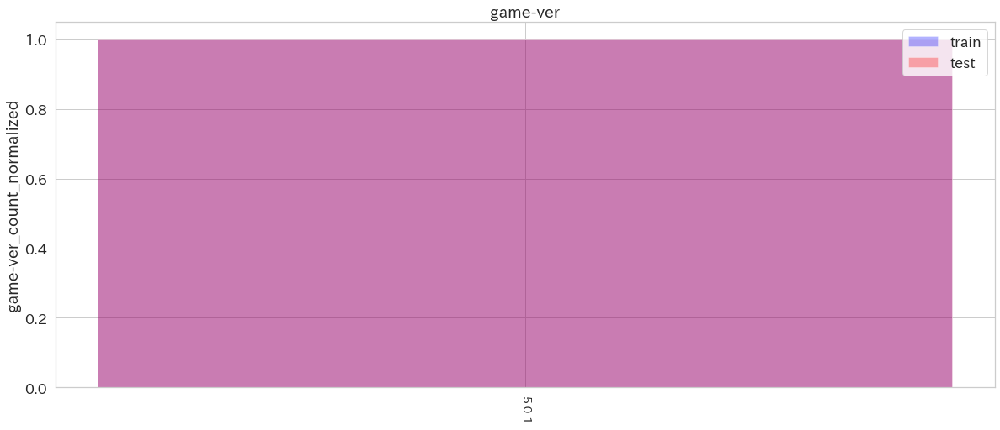

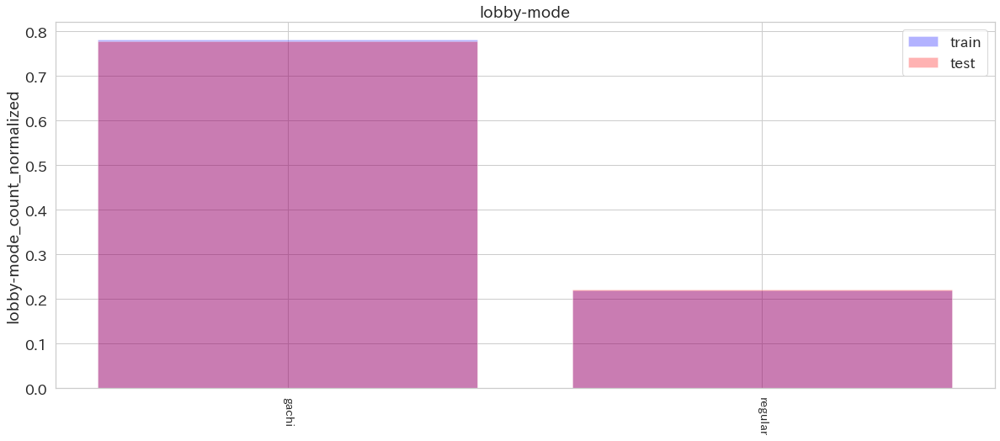

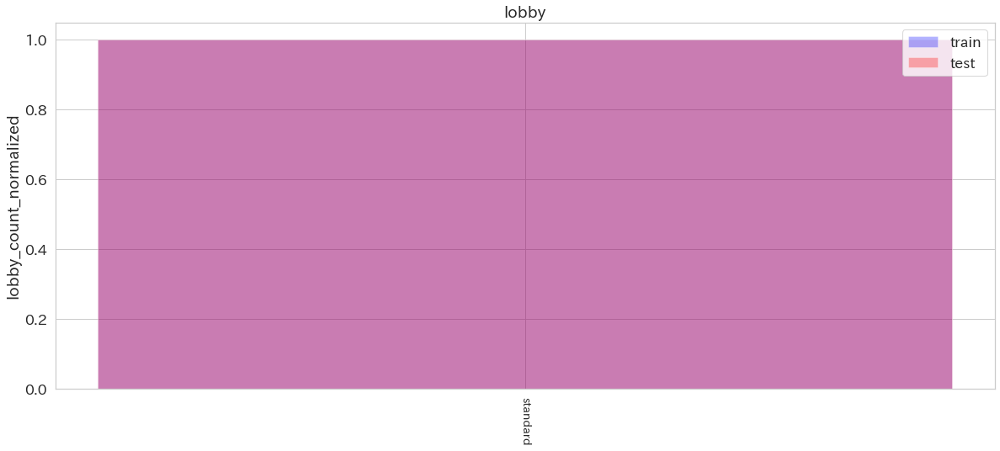

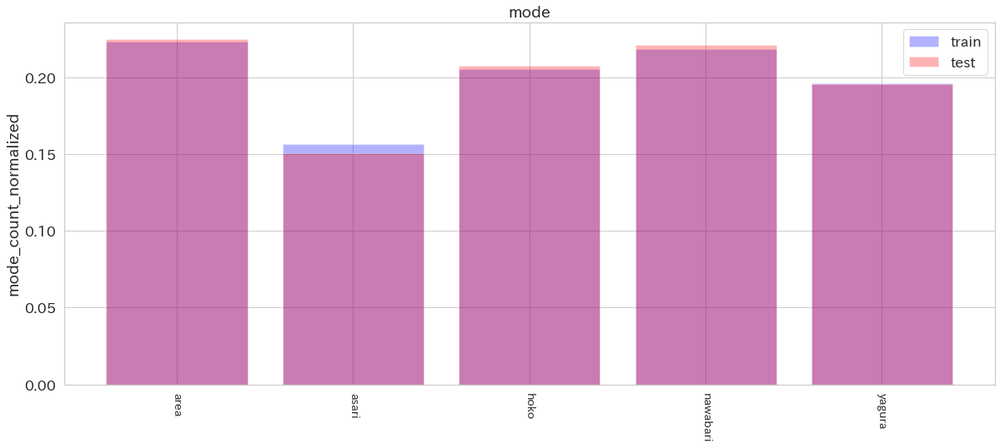

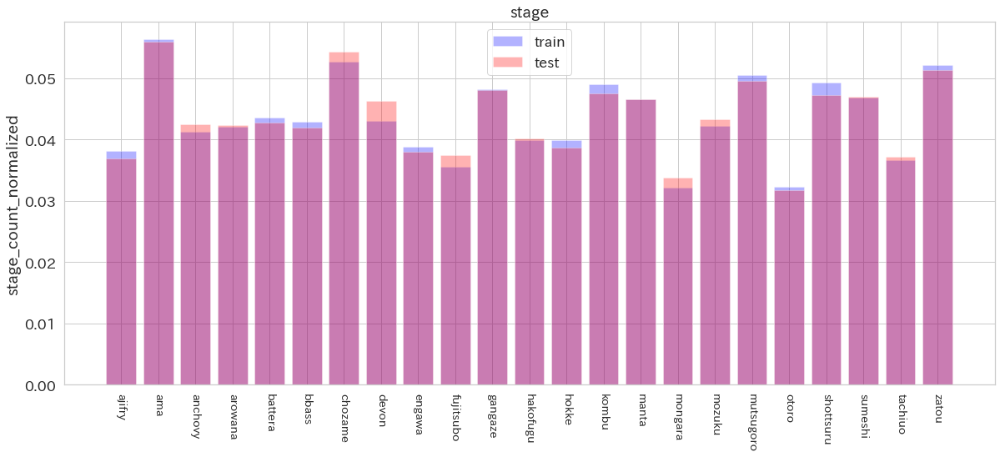

...

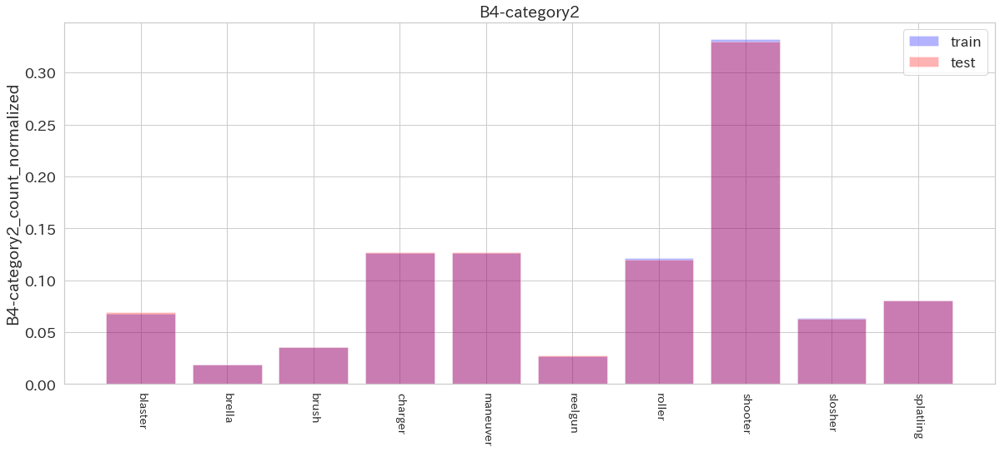

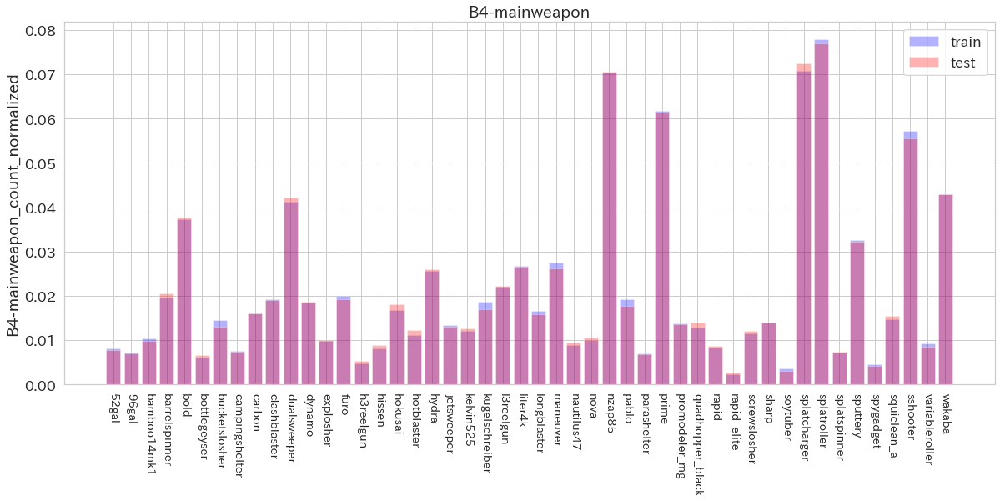

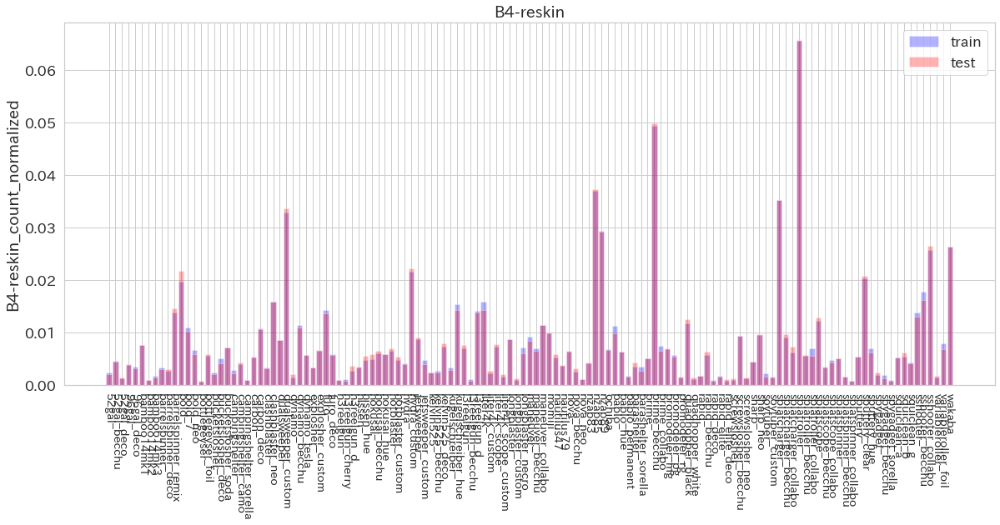

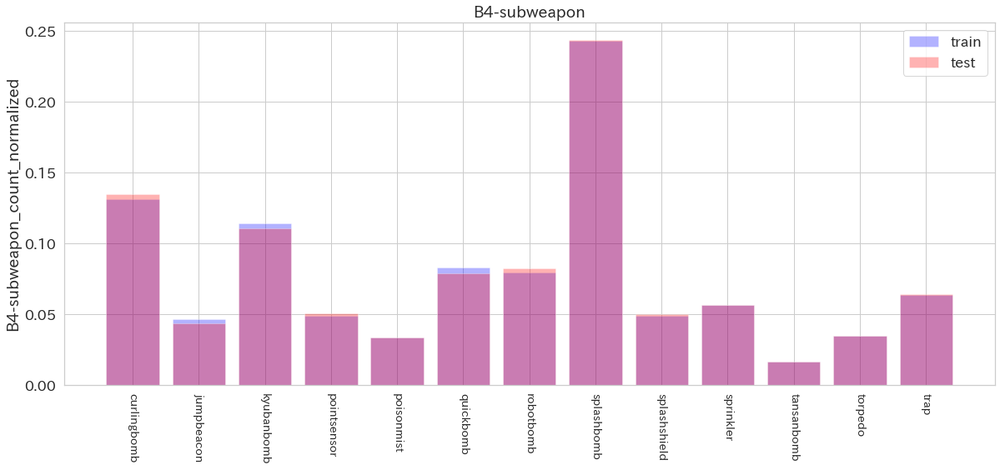

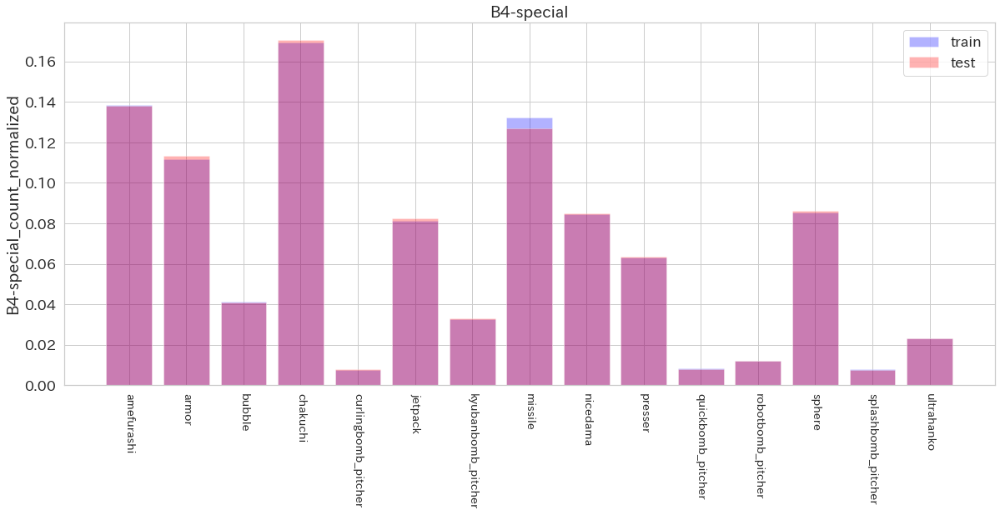

In [35]:
plot_config = {'bar': {'width': 0.8}}
for c in train_df.select_dtypes("object").columns[1:]:
    plot_train_test(train_df, test_df, c, {c : ['count']}, plot_config)

In [65]:
train_df["y_pred"] = pd.read_csv("case15_pred_valid.csv")["y"]
train_df["y_pred_class"] = np.rint(train_df["y_pred"]).astype(int)

C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\mikan\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [99]:
train_df["A1-mainweapon"].unique(), train_df["A1-category2"].unique()

(array(['sshooter', 'parashelter', 'nzap85', 'bamboo14mk1', 'bold',
        'dualsweeper', 'splatspinner', 'prime', 'barrelspinner', 'rapid',
        'squiclean_a', 'hydra', 'hissen', 'splatcharger', 'splatroller',
        'screwslosher', 'l3reelgun', 'furo', 'carbon', 'hokusai',
        'sputtery', 'wakaba', 'bucketslosher', 'kugelschreiber', 'dynamo',
        'maneuver', 'nova', 'sharp', 'liter4k', 'kelvin525', 'explosher',
        'promodeler_mg', 'h3reelgun', 'jetsweeper', '96gal',
        'bottlegeyser', 'variableroller', 'rapid_elite', 'nautilus47',
        'campingshelter', 'longblaster', 'pablo', 'spygadget',
        'hotblaster', 'quadhopper_black', 'clashblaster', '52gal',
        'soytuber'], dtype=object),
 array(['shooter', 'brella', 'charger', 'maneuver', 'splatling', 'blaster',
        'slosher', 'roller', 'reelgun', 'brush'], dtype=object))

In [71]:
df = train_df[train_df["lobby-mode"] == "regular"]
df = df[df["y"] != df["y_pred_class"]]

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y,y_pred,y_pred_class
1,2,2019-12-14T04:00:00+00:00,5.0.1,regular,standard,nawabari,arowana,NaN,198,parashelter_sorella,brella,brella,parashelter,parashelter_sorella,robotbomb,splashbomb_pitcher,NaN,77.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,NaN,198.0,campingshelter_camo,brella,brella,campingshelter,campingshelter_camo,trap,ultrahanko,NaN,123.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,NaN,83,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,NaN,118.0,squiclean_b,charger,charger,squiclean_a,squiclean_b,robotbomb,sphere,NaN,168.0,campingshelter,brella,brella,campingshelter,campingshelter,jumpbeacon,bubble,NaN,151.0,sputtery_clear,shooter,maneuver,sputtery,sputtery_clear,torpedo,chakuchi,0.0,0.565659,1
3,4,2019-11-11T14:00:00+00:00,5.0.1,regular,standard,nawabari,engawa,NaN,336,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,131.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,189.0,dynamo_tesla,roller,roller,dynamo,dynamo_tesla,splashbomb,armor,NaN,41.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,273,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,189.0,liter4k,charger,charger,liter4k,liter4k,trap,amefurashi,NaN,194.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,391.0,hotblaster_custom,shooter,blaster,hotblaster,hotblaster_custom,robotbomb,jetpack,0.0,0.592101,1
16,17,2019-11-02T12:00:00+00:00,5.0.1,regular,standard,nawabari,chozame,NaN,176,hydra_custom,splatling,splatling,hydra,hydra_custom,trap,armor,NaN,113.0,furo,slosher,slosher,furo,furo,splashshield,amefurashi,NaN,95.0,furo,slosher,slosher,furo,furo,splashshield,amefurashi,NaN,83.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,NaN,197,splatscope_collabo,charger,charger,splatcharger,splatscope_collabo,splashshield,kyubanbomb_pitcher,NaN,169.0,barrelspinner_remix,splatling,splatling,barrelspinner,barrelspinner_remix,pointsensor,nicedama,NaN,96.0,ochiba,shooter,shooter,wakaba,ochiba,torpedo,bubble,NaN,117.0,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,0.0,0.514358,1
27,28,2019-11-14T16:00:00+00:00,5.0.1,regular,standard,nawabari,mongara,NaN,108,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,NaN,56.0,promodeler_pg,shooter,shooter,promodeler_mg,promodeler_pg,quickbomb,nicedama,NaN,184.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,NaN,64.0,bamboo14mk2,charger,charger,bamboo14mk1,bamboo14mk2,poisonmist,quickbomb_pitcher,NaN,17,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,153.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,NaN,16.0,prime,shooter,shooter,prime,prime,pointsensor,amefurashi,NaN,139.0,screwslosher_becchu,slosher,slosher,screwslosher,screwslosher_becchu,tansanbomb,chakuchi,0.0,0.563168,1
44,45,2020-01-03T22:00:00+00:00,5.0.1,regular,standard,nawabari,gangaze,NaN,60,ochiba,shooter,shooter,wakaba,ochiba,torpedo,bubble,NaN,107.0

In [81]:
df[df.columns[df.columns.str.contains("-weapon|-level|-category1")].tolist() + ["y", "y_pred_class"]]

,A1-level,A1-weapon,A1-category1,A2-level,A2-weapon,A2-category1,A3-level,A3-weapon,A3-category1,A4-level,A4-weapon,A4-category1,B1-level,B1-weapon,B1-category1,B2-level,B2-weapon,B2-category1,B3-level,B3-weapon,B3-category1,B4-level,B4-weapon,B4-category1,y,y_pred_class
1,198,parashelter_sorella,brella,77.0,jetsweeper,shooter,198.0,campingshelter_camo,brella,123.0,nzap85,shooter,83,momiji,shooter,118.0,squiclean_b,charger,168.0,campingshelter,brella,151.0,sputtery_clear,shooter,0.0,1
3,336,bamboo14mk1,charger,131.0,splatroller_becchu,roller,189.0,dynamo_tesla,roller,41.0,prime_becchu,shooter,273,splatcharger_becchu,charger,189.0,liter4k,charger,194.0,promodeler_mg,shooter,391.0,hotblaster_custom,shooter,0.0,1
16,176,hydra_custom,splatling,113.0,furo,slosher,95.0,furo,slosher,83.0,nzap85,shooter,197,splatscope_collabo,charger,169.0,barrelspinner_remix,splatling,96.0,ochiba,shooter,117.0,sharp_neo,shooter,0.0,1
27,108,dualsweeper_custom,shooter,56.0,promodeler_pg,shooter,184.0,splatroller,roller,64.0,bamboo14mk2,charger,17,promodeler_mg,shooter,153.0,splatroller,roller,16.0,prime,shooter,139.0,screwslosher_becchu,slosher,0.0,1
44,60,ochiba,shooter,107.0,momiji,shooter,329.0,bamboo14mk3,charger,11.0,nzap89,shooter,102,dynamo_tesla,roller,45.0,maneuver,shooter,88.0,heromaneuver_replica,shooter,108.0,nova_neo,shooter,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66033,299,sputtery,shooter,380.0,kugelschreiber_hue,splatling,134.0,quadhopper_black,shooter,216.0,quadhopper_black,shooter,118,bamboo14mk1,charger,112.0,herocharger_replica,charger,159.0,bamboo14mk1,charger,60.0,wakaba,shooter,0.0,1
66048,201,96gal,shooter,20.0,bold,shooter,141.0,maneuver,shooter,43.0,nzap89,shooter,311,nzap89,shooter,47.0,promodeler_pg,shooter,27.0,bold,shooter,138.0,barrelspinner_remix,splatling,1.0,0
66090,563,l3reelgun,shooter,86.0,prime_becchu,shooter,205.0,bottlegeyser_foil,shooter,8.0,hotblaster,shooter,130,wakaba,shooter,267.0,momiji,shooter,74.0,prime_becchu,shooter,224.0,splatroller,roller,0.0,1
66099,62,l3reelgun,shooter,63.0,promodeler_pg,shooter,108.0,promodeler_pg,shooter,138.0,liter4k_scope,charger,242,jetsweeper,shooter,272.0,explosher_custom,slosher,143.0,bamboo14mk1,charger,122.0,prime,shooter,1.0,0


In [78]:
temp = pd.read_csv("case15_single.csv")

In [91]:
temp.columns.tolist()

['id',
 'lobby-mode',
 'mode',
 'stage',
 'y',
 'period_hour',
 'A-shooters',
 'A-brellas',
 'A-chargers',
 'A-splatlings',
 'A-sloshers',
 'A-rollers',
 'B-shooters',
 'B-chargers',
 'B-sloshers',
 'B-rollers',
 'B-splatlings',
 'B-brellas',
 'shooters_sub',
 'brellas_sub',
 'chargers_sub',
 'splatlings_sub',
 'sloshers_sub',
 'rollers_sub',
 'rank-zone',
 'A-category1',
 'A-category2',
 'B-category1',
 'B-category2',
 'A-rank_mean',
 'A-rank_std',
 'A-rank_max',
 'A-rank_min',
 'A-rank_skew',
 'A-rank_sem',
 'A-rank_mad',
 'A-rank_kurt',
 'A-level_mean',
 'A-level_std',
 'A-level_max',
 'A-level_min',
 'A-level_skew',
 'A-level_sem',
 'A-level_mad',
 'A-level_kurt',
 'A-weapon_mean',
 'A-weapon_std',
 'A-weapon_max',
 'A-weapon_min',
 'A-weapon_skew',
 'A-weapon_sem',
 'A-weapon_mad',
 'A-weapon_kurt',
 'A-mainweapon_mean',
 'A-mainweapon_std',
 'A-mainweapon_max',
 'A-mainweapon_min',
 'A-mainweapon_skew',
 'A-mainweapon_sem',
 'A-mainweapon_mad',
 'A-mainweapon_kurt',
 'A-reskin_me

In [90]:
temp.iloc[df.index][["A-level_mean", "A-weapon_mean", "A-category1_mean", "B-level_mean", "B-weapon_mean", "B-category1"]]

KeyError: "['A-category1_mean'] not in index"

In [24]:
# swap augmetation
swap = all_df.dropna(subset=["y"]).copy()
swap.columns = swap.columns.str.replace("A", "A_temp")
swap.columns = swap.columns.str.replace("B", "A")
swap.columns = swap.columns.str.replace("A_temp", "B")
swap = swap[all_df.columns]
swap["y"] = 1 - swap["y"]
swap["id"] = swap["id"] + len(swap)
all_df = pd.concat([all_df.dropna(subset=["y"]), swap, all_df[all_df["y"].isnull()]], axis=0).reset_index(drop=True)
del swap
gc.collect()

4

In [25]:
all_df[all_df["mode"] == "hoko"]

,id,period,game-ver,lobby-mode,lobby,mode,stage,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
2,3,2019-12-25T14:00:00+00:00,5.0.1,gachi,standard,hoko,ama,a-,114,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,a,68.0,quadhopper_black,shooter,maneuver,quadhopper_black,quadhopper_black,robotbomb,chakuchi,a,225.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,107.0,jetsweeper,shooter,shooter,jetsweeper,jetsweeper,poisonmist,missile,a-,50,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,a+,163.0,nzap85,shooter,shooter,nzap85,nzap85,kyubanbomb,armor,a-,160.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,a,126.0,dualsweeper_custom,shooter,maneuver,dualsweeper,dualsweeper_custom,splashbomb,amefurashi,0.0
4,5,2019-12-14T06:00:00+00:00,5.0.1,gachi,standard,hoko,chozame,x,299,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,x,97.0,hissen_hue,slosher,slosher,hissen,hissen_hue,splashbomb,amefurashi,x,96.0,h3reelgun_d,shooter,reelgun,h3reelgun,h3reelgun_d,kyubanbomb,armor,x,136.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,x,101,furo,slosher,slosher,furo,furo,splashshield,amefurashi,x,45.0,sputtery_hue,shooter,maneuver,sputtery,sputtery_hue,poisonmist,amefurashi,x,246.0,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher,x,160.0,wakaba,shooter,shooter,wakaba,wakaba,splashbomb,armor,1.0
6,7,2019-11-10T14:00:00+00:00,5.0.1,gachi,standard,hoko,hokke,b,27,dualsweeper,shooter,maneuver,dualsweeper,dualsweeper,pointsensor,missile,b-,30.0,maneuver_becchu,shooter,maneuver,maneuver,maneuver_becchu,kyubanbomb,sphere,b,41.0,splatspinner,splatling,splatling,splatspinner,splatspinner,quickbomb,missile,b-,49.0,heromaneuver_replica,shooter,maneuver,maneuver,maneuver,quickbomb,missile,b-,50,liter4k_scope,charger,charger,liter4k,liter4k_scope,trap,amefurashi,b-,25.0,furo_deco,slosher,slosher,furo,furo_deco,sprinkler,kyubanbomb_pitcher,b,34.0,maneuver_becchu,shooter,maneuver,maneuver,maneuver_becchu,kyubanbomb,sphere,b-,35.0,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,1.0
11,12,2019-10-18T08:00:00+00:00,5.0.1,gachi,standard,hoko,mutsugoro,x,116,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,x,202.0,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,x,233.0,wakaba,shooter,shooter,wakaba,wakaba,splashbomb,armor,x,70.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,x,142,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,x,143.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,x,177.0,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,x,213.0,hissen,slosher,slosher,hissen,hissen,quickbomb,armor,1.0
15,16,2019-12-02T14:00:00+00:00,5.0.1,gachi,standard,hoko,mozuku,x,179,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,x,261.0,heroroller_replica,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,x,263.0,ochiba,shooter,shooter,wakaba,ochiba,torpedo,bubble,x,184.0,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,x,319,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,x,197.0,wakaba,sho

In [26]:
target = "y"
train_df = all_df.dropna(subset=[target]).copy()
test_df = all_df.loc[all_df[target].isnull()].copy()

target_means_all = train_df[train_df["mode"] == "hoko"].groupby("stage")[target].mean()
target_means_all
# # validation is replaced by the target mean of entire train
# test_df[c] = test_df[c].map(target_means_all)

stage
ama          0.5
anchovy      0.5
arowana      0.5
battera      0.5
bbass        0.5
chozame      0.5
devon        0.5
engawa       0.5
fujitsubo    0.5
gangaze      0.5
hakofugu     0.5
hokke        0.5
kombu        0.5
manta        0.5
mongara      0.5
mozuku       0.5
mutsugoro    0.5
otoro        0.5
shottsuru    0.5
sumeshi      0.5
tachiuo      0.5
zatou        0.5
Name: y, dtype: float64

In [18]:
pd.read_csv("case08_multiple_hoko.csv")

,id,stage,y,period_hour,A-rank_mean,A-rank_std,A-rank_max,A-rank_min,A-level_mean,A-level_std,A-level_max,A-level_min,A-weapon_mean,A-weapon_std,A-weapon_max,A-weapon_min,A-category1_mean,A-category1_std,A-category1_max,A-category1_min,A-category2_mean,A-category2_std,A-category2_max,A-category2_min,A-mainweapon_mean,A-mainweapon_std,A-mainweapon_max,A-mainweapon_min,A-reskin_mean,A-reskin_std,A-reskin_max,A-reskin_min,A-subweapon_mean,A-subweapon_std,A-subweapon_max,A-subweapon_min,A-special_mean,A-special_std,A-special_max,A-special_min,A-overall_mean,B-rank_mean,B-rank_std,B-rank_max,B-rank_min,B-level_mean,B-level_std,B-level_max,B-level_min,B-weapon_mean,B-weapon_std,B-weapon_max,B-weapon_min,B-category1_mean,B-category1_std,B-category1_max,B-category1_min,B-category2_mean,B-category2_std,B-category2_max,B-category2_min,B-mainweapon_mean,B-mainweapon_std,B-mainweapon_max,B-mainweapon_min,B-reskin_mean,B-reskin_std,B-reskin_max,B-reskin_min,B-subweapon_mean,B-subweapon_std,B-subweapon_max,B-subweapon_min,B-special_mean,B-special_std,B-special_max,B-special_min,B-overall_mean,rank_mean_sub,rank_max_sub,rank_std_sub,rank_min_sub,rank_mean_div,rank_max_div,level_mean_sub,level_max_sub,level_std_sub,level_min_sub,level_mean_div,level_max_div,weapon_mean_sub,weapon_max_sub,weapon_std_sub,weapon_min_sub,weapon_mean_div,weapon_max_div,category1_mean_sub,category1_max_sub,category1_std_sub,category1_min_sub,category1_mean_div,category1_max_div,category2_mean_sub,category2_max_sub,category2_std_sub,category2_min_sub,category2_mean_div,category2_max_div,mainweapon_mean_sub,mainweapon_max_sub,mainweapon_std_sub,mainweapon_min_sub,mainweapon_mean_div,mainweapon_max_div,reskin_mean_sub,reskin_max_sub,reskin_std_sub,reskin_min_sub,reskin_mean_div,reskin_max_div,subweapon_mean_sub,subweapon_max_sub,subweapon_std_sub,subweapon_min_sub,subweapon_mean_div,subweapon_max_div,special_mean_sub,special_max_sub,special_std_sub,special_min_sub,special_mean_div,special_max_div,overall_mean_sub,overall_mean_div
0,3,0.505875,0.0,7,0.492679,0.013331,0.511772,0.480745,128.50,67.441330,225.0,68.0,0.485275,0.020322,0.506925,0.459459,0.501160,0.002605,0.504953,0.499238,0.503556,0.008122,0.510811,0.493492,0.480153,0.029210,0.507370,0.438710,0.485275,0.020322,0.506925,0.459459,0.495020,0.005436,0.500629,0.487580,0.499430,0.003466,0.501903,0.494327,21.824192,0.499914,0.013695,0.514654,0.485219,124.75,52.582478,163.0,50.0,0.477181,0.010948,0.490119,0.465160,0.498306,0.002723,0.500839,0.494620,0.497371,0.006305,0.504658,0.489416,0.487061,0.007025,0.494041,0.480217,0.477181,0.010948,0.490119,0.465160,0.495070,0.001519,0.496811,0.493465,0.487389,0.015386,0.505998,0.473705,21.195647,-0.007234,-0.002882,-3.647761e-04,-0.004474,0.985529,0.994400,3.75,62.0,14.858852,18.0,1.030060,1.380368,0.008094,0.016807,0.009374,-0.005701,1.016962,1.034291,0.002854,0.004114,-1.178510e-04,0.004618,1.005727,1.008214,0.006185,0.006153,1.816249e-03,0.004076,1.012436,1.012192,-0.006909,0.013329,0.022185,-0.041508,0.985816,1.026979,0.008094,0.016807,0.009374,-0.005701,1.016962,1.034291,-0.000050,0.003818,0.003917,-0.005885,0.999898,1.007685,0.012041,-0.004095,-0.011920,0.020623,1.024705,0.991908,0.628545,1.029654
1,5,0.499226,1.0,3,0.499642,0.000143,0.499857,0.499571,157.00,96.481430,299.0,96.0,0.540400,0.026056,0.571429,0.510338,0.505491,0.003947,0.510303,0.500660,0.507239,0.008359,0.515498,0.496192,0.526346,0.017523,0.549451,0.507138,0.539959,0.026742,0.571429,0.508571,0.506437,0.005798,0.514730,0.501414,0.502443,0.009256,0.515385,0.495284,26.602597,0.499487,0.000167,0.499571,0.499236,138.00,85.957350,246.0,45.0,0.473848,0.038432,0.519672,0.436047,0.497246,0.003260,0.500408,0.492717,0.492709,0.005008,0.497459,0.485783,0.497524,0.016858,0.522573,0.486842,0.473848,0.038432,0.519672,0.436047,0.498658,0.012154,0.508427,0.481066,0.485358,0.029652,0.504813,0.441489,23.404873,0.000155,0.000286,-2.425909e-05,0.000335,1.000311,1.000573,19.00,53.0,10.524078,51.0,1.137681,1.215447,0.066552,0.05

In [28]:
reg = all_df[all_df["lobby-mode"] == "regular"]
gac = all_df[all_df["lobby-mode"] == "gachi"]

In [38]:
cols = reg.columns[reg.columns.str.contains("A.-|B.-")].tolist() + ["y"]

In [39]:
reg.isnull().sum().sort_values(ascending=False).head(40)

B2-rank          20716
B3-rank          20716
A1-rank          20716
A2-rank          20716
A3-rank          20716
A4-rank          20716
B1-rank          20716
B4-rank          20716
y                 6272
A4-weapon           15
A4-category2        15
B4-special          15
A4-reskin           15
A4-subweapon        15
A4-special          15
A4-level            15
A4-category1        15
A4-mainweapon       15
B4-mainweapon       15
B4-reskin           15
B4-category2        15
B4-category1        15
B4-weapon           15
B4-level            15
B4-subweapon        15
B3-category2         1
B3-special           1
B3-subweapon         1
B3-reskin            1
B3-mainweapon        1
B3-level             1
B3-category1         1
B3-weapon            1
lobby-mode           0
A2-subweapon         0
A2-reskin            0
A2-mainweapon        0
A2-category2         0
A2-category1         0
A2-weapon            0
dtype: int64

In [40]:
reg[reg["A4-weapon"].isnull()][cols]

,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
402,NaN,46,heromaneuver_replica,shooter,maneuver,maneuver,maneuver,quickbomb,missile,NaN,224.0,splatroller_collabo,roller,roller,splatroller,splatroller_collabo,jumpbeacon,sphere,NaN,20.0,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,152,96gal,shooter,shooter,96gal,96gal,sprinkler,armor,NaN,103.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,43.0,momiji,shooter,shooter,wakaba,momiji,robotbomb,amefurashi,NaN,53.0,pablo,roller,brush,pablo,pablo,splashbomb,chakuchi,1.0
11377,NaN,31,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher,NaN,14.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,43.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,quadhopper_black,shooter,maneuver,quadhopper_black,quadhopper_black,robotbomb,chakuchi,NaN,23.0,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,28.0,splatroller_becchu,roller,roller,splatroller,splatroller_becchu,splashbomb,bubble,NaN,34.0,52gal_becchu,shooter,shooter,52gal,52gal_becchu,splashshield,nicedama,1.0
31194,NaN,142,maneuver_collabo,shooter,maneuver,maneuver,maneuver_collabo,curlingbomb,jetpack,NaN,15.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,38.0,hotblaster,shooter,blaster,hotblaster,hotblaster,poisonmist,chakuchi,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,49.0,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,54.0,sputtery_clear,shooter,maneuver,sputtery,sputtery_clear,torpedo,chakuchi,NaN,50.0,octoshooter_replica,shooter,shooter,sshooter,sshooter_collabo,splashbomb,jetpack,0.0
35297,NaN,123,bold_neo,shooter,shooter,bold,bold_neo,jumpbeacon,missile,NaN,75.0,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,71.0,bamboo14mk1,charger,charger,bamboo14mk1,bamboo14mk1,curlingbomb,missile,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,212,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,40.0,sshooter,shooter,shooter,sshooter,sshooter,quickbomb,chakuchi,NaN,87.0,sshooter_collabo,shooter,shooter,sshooter,sshooter_collabo,splashbomb,jetpack,NaN,78.0,sharp,shooter,shooter,sharp,sharp,poisonmist,jetpack,0.0
37293,NaN,102,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,223.0,dualsweeper,shooter,maneuver,dualsweeper,dualsweeper,pointsensor,missile,NaN,70.0,carbon_deco,roller,roller,carbon,carbon_deco,quickbomb,robotbomb_pitcher,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,109.0,promodeler_rg,shooter,shooter,promodeler_mg,promodeler_rg,sprinkler,sphere,NaN,74.0,bold_7,shooter,shooter,bold,bold_7,splashbomb,ultrahanko,NaN,109.0,barrelspinner_remix,splatling,splatling,barrelspinner,barrelspinner_remix,pointsensor,nicedama,0.0
43033,NaN,45,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,55.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,192.0,sshooter,shooter,shooter,sshooter,sshooter,quickbomb,chakuchi,NaN,NaN,

In [42]:
reg[reg["B4-weapon"].isnull()][cols]

,A1-rank,A1-level,A1-weapon,A1-category1,A1-category2,A1-mainweapon,A1-reskin,A1-subweapon,A1-special,A2-rank,A2-level,A2-weapon,A2-category1,A2-category2,A2-mainweapon,A2-reskin,A2-subweapon,A2-special,A3-rank,A3-level,A3-weapon,A3-category1,A3-category2,A3-mainweapon,A3-reskin,A3-subweapon,A3-special,A4-rank,A4-level,A4-weapon,A4-category1,A4-category2,A4-mainweapon,A4-reskin,A4-subweapon,A4-special,B1-rank,B1-level,B1-weapon,B1-category1,B1-category2,B1-mainweapon,B1-reskin,B1-subweapon,B1-special,B2-rank,B2-level,B2-weapon,B2-category1,B2-category2,B2-mainweapon,B2-reskin,B2-subweapon,B2-special,B3-rank,B3-level,B3-weapon,B3-category1,B3-category2,B3-mainweapon,B3-reskin,B3-subweapon,B3-special,B4-rank,B4-level,B4-weapon,B4-category1,B4-category2,B4-mainweapon,B4-reskin,B4-subweapon,B4-special,y
8873,NaN,55,longblaster,shooter,blaster,longblaster,longblaster,kyubanbomb,amefurashi,NaN,82.0,promodeler_rg,shooter,shooter,promodeler_mg,promodeler_rg,sprinkler,sphere,NaN,105.0,hydra_custom,splatling,splatling,hydra,hydra_custom,trap,armor,NaN,161.0,squiclean_g,charger,charger,squiclean_a,squiclean_g,kyubanbomb,jetpack,NaN,198,bucketslosher_soda,slosher,slosher,bucketslosher,bucketslosher_soda,splashbomb,quickbomb_pitcher,NaN,141.0,barrelspinner_deco,splatling,splatling,barrelspinner,barrelspinner_deco,splashshield,bubble,NaN,205.0,campingshelter_camo,brella,brella,campingshelter,campingshelter_camo,trap,ultrahanko,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
12319,NaN,48,heromaneuver_replica,shooter,maneuver,maneuver,maneuver,quickbomb,missile,NaN,14.0,splatroller,roller,roller,splatroller,splatroller,curlingbomb,chakuchi,NaN,45.0,promodeler_mg,shooter,shooter,promodeler_mg,promodeler_mg,kyubanbomb,curlingbomb_pitcher,NaN,40.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,80,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,28.0,splatscope,charger,charger,splatcharger,splatscope,splashbomb,presser,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
21519,NaN,61,sharp,shooter,shooter,sharp,sharp,poisonmist,jetpack,NaN,200.0,dynamo_becchu,roller,roller,dynamo,dynamo_becchu,sprinkler,nicedama,NaN,168.0,52gal_deco,shooter,shooter,52gal,52gal_deco,curlingbomb,presser,NaN,87.0,soytuber,charger,charger,soytuber,soytuber,kyubanbomb,chakuchi,NaN,53,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,383.0,splatscope_becchu,charger,charger,splatcharger,splatscope_becchu,sprinkler,sphere,NaN,146.0,heroshooter_replica,shooter,shooter,sshooter,sshooter,quickbomb,chakuchi,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
22042,NaN,134,h3reelgun_d,shooter,reelgun,h3reelgun,h3reelgun_d,kyubanbomb,armor,NaN,191.0,l3reelgun_d,shooter,reelgun,l3reelgun,l3reelgun_d,quickbomb,jetpack,NaN,366.0,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,134.0,splatcharger_becchu,charger,charger,splatcharger,splatcharger_becchu,sprinkler,sphere,NaN,66,bold,shooter,shooter,bold,bold,curlingbomb,chakuchi,NaN,99.0,l3reelgun,shooter,reelgun,l3reelgun,l3reelgun,curlingbomb,sphere,NaN,274.0,prime_collabo,shooter,shooter,prime,prime_collabo,kyubanbomb,bubble,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
32112,NaN,159,splatscope,charger,charger,splatcharger,splatscope,splashbomb,presser,NaN,126.0,wakaba,shooter,shooter,wakaba,wakaba,splashbomb,armor,NaN,102.0,liter4k_scope,charger,charger,liter4k,liter4k_scope,trap,amefurashi,NaN,260.0,prime_becchu,shooter,shooter,prime,prime_becchu,splashbomb,nicedama,NaN,168,sharp_neo,shooter,shooter,sharp,sharp_neo,quickbomb,kyubanbomb_pitcher,NaN,39.0,hokusai_hue,roller,brush,hokusai,hokusai_hue,jumpbeacon,missile,NaN,152.0,liter4k_scope,charger,charger,liter4k,liter4k_scope,trap,amefurashi,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
33847,NaN,181,hydra_custom,splatling,splatling,hydra,hydra_custom,trap,armor,NaN,73.0,splatroller_collabo,roller,roller,splatroller,splatroller_collabo,jumpbeacon,sphere,NaN,66.0,nzap89,shooter,shooter,nzap85,nzap89,robotbomb,missile,NaN,57

In [43]:
pd.read_csv("case11_single.csv")

,id,lobby-mode,mode,stage,y,period_hour,A-shooters,A-brellas,A-chargers,A-splatlings,A-sloshers,A-rollers,B-shooters,B-chargers,B-sloshers,B-rollers,B-splatlings,B-brellas,shooters_sub,brellas_sub,chargers_sub,splatlings_sub,sloshers_sub,rollers_sub,rank-zone,A-rank_mean,A-rank_std,A-rank_max,A-rank_min,A-level_mean,A-level_std,A-level_max,A-level_min,A-weapon_mean,A-weapon_std,A-weapon_max,A-weapon_min,A-category1_mean,A-category1_std,A-category1_max,A-category1_min,A-category2_mean,A-category2_std,A-category2_max,A-category2_min,A-mainweapon_mean,A-mainweapon_std,A-mainweapon_max,A-mainweapon_min,A-reskin_mean,A-reskin_std,A-reskin_max,A-reskin_min,A-subweapon_mean,A-subweapon_std,A-subweapon_max,A-subweapon_min,A-special_mean,A-special_std,A-special_max,A-special_min,A-overall_mean,B-rank_mean,B-rank_std,B-rank_max,B-rank_min,B-level_mean,B-level_std,B-level_max,B-level_min,B-weapon_mean,B-weapon_std,B-weapon_max,B-weapon_min,B-category1_mean,B-category1_std,B-category1_max,B-category1_min,B-category2_mean,B-category2_std,B-category2_max,B-category2_min,B-mainweapon_mean,B-mainweapon_std,B-mainweapon_max,B-mainweapon_min,B-reskin_mean,B-reskin_std,B-reskin_max,B-reskin_min,B-subweapon_mean,B-subweapon_std,B-subweapon_max,B-subweapon_min,B-special_mean,B-special_std,B-special_max,B-special_min,B-overall_mean,rank_mean_sub,rank_max_sub,rank_std_sub,rank_min_sub,rank_mean_div,rank_max_div,level_mean_sub,level_max_sub,level_std_sub,level_min_sub,level_mean_div,level_max_div,weapon_mean_sub,weapon_max_sub,weapon_std_sub,weapon_min_sub,weapon_mean_div,weapon_max_div,category1_mean_sub,category1_max_sub,category1_std_sub,category1_min_sub,category1_mean_div,category1_max_div,category2_mean_sub,category2_max_sub,category2_std_sub,category2_min_sub,category2_mean_div,category2_max_div,mainweapon_mean_sub,mainweapon_max_sub,mainweapon_std_sub,mainweapon_min_sub,mainweapon_mean_div,mainweapon_max_div,reskin_mean_sub,reskin_max_sub,reskin_std_sub,reskin_min_sub,reskin_mean_div,reskin_max_div,subweapon_mean_sub,subweapon_max_sub,subweapon_std_sub,subweapon_min_sub,subweapon_mean_div,subweapon_max_div,special_mean_sub,special_max_sub,special_std_sub,special_min_sub,special_mean_div,special_max_div,overall_mean_sub,overall_mean_div
0,1,0.499265,0.499265,0.503310,1.0,10,1,0,1,0,0,2,2,1,0,1,0,0,-1,0,0,0,0,1,0.499265,NaN,NaN,NaN,NaN,70.00,68.102870,139.0,10.0,0.515120,0.026031,0.552239,0.491422,0.492293,0.025857,0.507899,0.453614,0.489853,0.024272,0.505125,0.453614,0.487168,0.032229,0.513446,0.441989,0.520935,0.026996,0.552239,0.491422,0.502316,0.009248,0.516129,0.496539,0.498238,0.003705,0.501603,0.493768,12.087296,NaN,NaN,NaN,NaN,38.25,19.939491,68.0,26.0,0.515027,0.046503,0.582661,0.476819,0.507400,0.026742,0.547222,0.489653,0.509196,0.025544,0.547222,0.492080,0.513429,0.031823,0.559954,0.491817,0.516026,0.048442,0.586656,0.476819,0.500077,0.005042,0.505489,0.493428,0.510665,0.038611,0.566533,0.484697,6.800871,NaN,NaN,NaN,NaN,NaN,NaN,31.75,71.0,48.163376,-16.0,1.830065,2.044118,0.000092,-0.030422,-0.020472,0.014603,1.000180,0.947787,-0.015108,-0.039323,-0.000885,-0.036039,0.970225,0.928141,-0.019343,-0.042097,-0.001272,-0.038466,0.962013,0.923071,-0.026262,-0.046508,0.000406,-0.049828,0.948851,0.916944,0.004909,-0.034417,-0.021446,0.014603,1.009513,0.941333,0.002240,0.010640,0.004205,0.003110,1.004478,1.021048,-0.012427,-0.064930,-0.034905,0.009071,0.975665,0.885390,5.286425,1.777316
1,2,0.499935,0.499935,0.500451,0.0,2,2,2,0,0,0,0,2,1,0,0,0,1,0,1,-1,0,0,0,0.499935,NaN,NaN,NaN,NaN,149.00,59.615433,198.0,77.0,0.505962,0.009963,0.512887,0.491371,0.498238,0.007587,0.507341,0.491894,0.499421,0.008610,0.507616,0.491894,0.494383,0.004193,0.499865,0.490405,0.505962,0.009963,0.512887,0.491371,0.501070,0.008978,0.506199,0.487671,0.502941,0.010441,0.512226,0.493676,25.251720,NaN,NaN,NaN,NaN,130.00,37.585457,168.0,83.0,0.499393,0.014560,0.515284,0.483981,0.512178,0.024297,0.548331,0.496920,0.513573,0.023228,0.548331,0.500826,0.508778,0.019405,0.5363

In [16]:
all_df.columns

Index(['id', 'period', 'game-ver', 'lobby-mode', 'lobby', 'mode', 'stage',
       'A1-rank', 'A1-level', 'A1-weapon', 'A1-category1', 'A1-category2',
       'A1-mainweapon', 'A1-reskin', 'A1-subweapon', 'A1-special', 'A2-rank',
       'A2-level', 'A2-weapon', 'A2-category1', 'A2-category2',
       'A2-mainweapon', 'A2-reskin', 'A2-subweapon', 'A2-special', 'A3-rank',
       'A3-level', 'A3-weapon', 'A3-category1', 'A3-category2',
       'A3-mainweapon', 'A3-reskin', 'A3-subweapon', 'A3-special', 'A4-rank',
       'A4-level', 'A4-weapon', 'A4-category1', 'A4-category2',
       'A4-mainweapon', 'A4-reskin', 'A4-subweapon', 'A4-special', 'B1-rank',
       'B1-level', 'B1-weapon', 'B1-category1', 'B1-category2',
       'B1-mainweapon', 'B1-reskin', 'B1-subweapon', 'B1-special', 'B2-rank',
       'B2-level', 'B2-weapon', 'B2-category1', 'B2-category2',
       'B2-mainweapon', 'B2-reskin', 'B2-subweapon', 'B2-special', 'B3-rank',
       'B3-level', 'B3-weapon', 'B3-category1', 'B3-category2'

In [17]:
all_df.isnull().sum().sort_values(ascending=False).head(20)

y                28340
B4-rank          20798
A4-rank          20767
B3-rank          20717
B2-rank          20716
A2-rank          20716
A1-rank          20716
A3-rank          20716
B1-rank          20716
B4-level            97
B4-weapon           97
B4-category1        97
B4-category2        97
B4-mainweapon       97
B4-reskin           97
B4-subweapon        97
B4-special          97
A4-level            66
A4-weapon           66
A4-category1        66
dtype: int64

In [18]:
all_df[all_df["lobby-mode"] == "regular"].shape, all_df[all_df["lobby-mode"] == "regular"].isnull().sum().sort_values(ascending=False).head(20)

((20716, 80),
 B2-rank          20716
 B3-rank          20716
 A1-rank          20716
 A2-rank          20716
 A3-rank          20716
 A4-rank          20716
 B1-rank          20716
 B4-rank          20716
 y                 6272
 A4-weapon           15
 A4-category2        15
 B4-special          15
 A4-reskin           15
 A4-subweapon        15
 A4-special          15
 A4-level            15
 A4-category1        15
 A4-mainweapon       15
 B4-mainweapon       15
 B4-reskin           15
 dtype: int64)

In [19]:
all_df[all_df["lobby-mode"] == "gachi"].shape, all_df[all_df["lobby-mode"] == "gachi"].isnull().sum().sort_values(ascending=False).head(20)

((73749, 80),
 y                22068
 B4-category1        82
 B4-special          82
 B4-level            82
 B4-weapon           82
 B4-rank             82
 B4-category2        82
 B4-mainweapon       82
 B4-reskin           82
 B4-subweapon        82
 A4-special          51
 A4-rank             51
 A4-level            51
 A4-weapon           51
 A4-category1        51
 A4-category2        51
 A4-reskin           51
 A4-subweapon        51
 A4-mainweapon       51
 B3-level             1
 dtype: int64)

In [28]:
all_df["A-rank"] = all_df["A1-rank"] + "_" + all_df["A2-rank"] + "_" + all_df["A3-rank"] + "_" + all_df["A4-rank"]
all_df["B-rank"] = all_df["B1-rank"] + "_" + all_df["B2-rank"] + "_" + all_df["B3-rank"] + "_" + all_df["B4-rank"]
all_df["A-level"] = all_df["A1-level"] + all_df["A2-level"] + all_df["A3-level"] + all_df["A4-level"]
all_df["B-level"] = all_df["B1-level"] + all_df["B2-level"] + all_df["B3-level"] + all_df["B4-level"]
all_df["A-category1"] = all_df["A1-category1"] + "_" + all_df["A2-category1"] + "_" + all_df["A3-category1"] + "_" + all_df["A4-category1"]
all_df["B-category1"] = all_df["B1-category1"] + "_" + all_df["B2-category1"] + "_" + all_df["B3-category1"] + "_" + all_df["B4-category1"]
all_df["A-category2"] = all_df["A1-category2"] + "_" + all_df["A2-category2"] + "_" + all_df["A3-category2"] + "_" + all_df["A4-category2"]
all_df["B-category2"] = all_df["B1-category2"] + "_" + all_df["B2-category2"] + "_" + all_df["B3-category2"] + "_" + all_df["B4-category2"]
all_df["A-subweapon"] = all_df["A1-subweapon"] + "_" + all_df["A2-subweapon"] + "_" + all_df["A3-subweapon"] + "_" + all_df["A4-subweapon"]
all_df["B-subweapon"] = all_df["B1-subweapon"] + "_" + all_df["B2-subweapon"] + "_" + all_df["B3-subweapon"] + "_" + all_df["B4-subweapon"]
all_df["A-special"] = all_df["A1-special"] + "_" + all_df["A2-special"] + "_" + all_df["A3-special"] + "_" + all_df["A4-special"]
all_df["B-special"] = all_df["B1-special"] + "_" + all_df["B2-special"] + "_" + all_df["B3-special"] + "_" + all_df["B4-special"]

In [79]:
def team_stats(df):
    for team in ["A", "B"]:
        # category
        for i in range(1, 3, 1):
            temp = df[df.columns[df.columns.str.contains(team + ".-category" + str(i))]].replace(np.nan, "NaN")
            temp.values.sort(axis=1)
            df[df.columns[df.columns.str.contains(team + ".-category" + str(i))]] = temp
            df[team + "-category" + str(i)] = df[team + "1-category" + str(i)] + "_" \
                                            + df[team + "2-category" + str(i)] + "_" \
                                            + df[team + "3-category" + str(i)] + "_" \
                                            + df[team + "4-category" + str(i)]    
    return df

In [80]:
all_df = team_stats(all_df)

In [90]:
for cat in all_df["A-category1"].unique():
    temp = all_df[all_df["A-category1"] == cat].copy()
    #display(temp)
    temp2 = temp["y"].value_counts(normalize=True).sort_index().values
    #print(temp["y"].value_counts(normalize=True).sort_index())
    
    if len(temp2) < 2:
        continue
    #temp["Elo_rating"] = np.log10(temp2[1]/temp2[0])
    all_df["Elo_rating"].loc[temp.index] = np.log10(temp2[1]/temp2[0])

In [91]:
all_df["Elo_rating"].value_counts(dropna=False)

 0.071848    12006
 0.004568     7651
 0.105039     7304
 0.061094     6985
-0.010558     6793
             ...  
 0.176091       14
-0.176091       14
 0.845098       14
-0.221849       10
-0.397940        7
Name: Elo_rating, Length: 80, dtype: int64

In [93]:
all_df["A-category1"].value_counts().to_frame()

array([[12006],
       [ 7651],
       [ 7304],
       [ 6985],
       [ 6793],
       [ 6374],
       [ 6266],
       [ 5475],
       [ 3968],
       [ 3602],
       [ 2973],
       [ 2761],
       [ 1899],
       [ 1414],
       [ 1398],
       [ 1304],
       [ 1224],
       [ 1141],
       [ 1107],
       [ 1099],
       [  878],
       [  842],
       [  834],
       [  686],
       [  669],
       [  665],
       [  625],
       [  523],
       [  349],
       [  344],
       [  336],
       [  334],
       [  315],
       [  272],
       [  261],
       [  258],
       [  254],
       [  246],
       [  225],
       [  220],
       [  215],
       [  208],
       [  204],
       [  181],
       [  168],
       [  121],
       [  100],
       [   77],
       [   68],
       [   65],
       [   61],
       [   58],
       [   58],
       [   57],
       [   50],
       [   38],
       [   36],
       [   34],
       [   33],
       [   32],
       [   31],
       [   27],
       [

In [113]:
all_df["A-category1"] = all_df["A-category1"].replace(all_df["A-category1"].value_counts()[all_df["A-category1"].value_counts() < 20].index, "other")

In [117]:
all_df["A-category1"].value_counts().loc["other"]

585

In [57]:
all_df.groupby("A-category1")["y"].value_counts(normalize=True)

A-category1                            y  
NaN_brella_charger_shooter             0.0    1.000000
NaN_brella_roller_shooter              0.0    1.000000
NaN_brella_shooter_shooter             0.0    1.000000
NaN_brella_shooter_slosher             0.0    1.000000
NaN_charger_roller_shooter             0.0    1.000000
                                                ...   
shooter_splatling_splatling_splatling  0.0    0.352941
slosher_slosher_slosher_splatling      1.0    1.000000
slosher_slosher_splatling_splatling    0.0    1.000000
slosher_splatling_splatling_splatling  0.0    0.666667
                                       1.0    0.333333
Name: y, Length: 236, dtype: float64

In [67]:
temp = all_df[all_df["A-category1"] == "shooter_shooter_shooter_splatling"]["y"].value_counts(normalize=True).sort_index()
temp

0.0    0.464889
1.0    0.535111
Name: y, dtype: float64

In [68]:
np.log10(temp[1]/temp[0])

0.06109448653255229

In [21]:
def countplot(df, x, hue=None):
    f, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    sns.countplot(x=x, data=df, hue=hue, ax=ax)
    plt.legend(bbox_to_anchor=(1.01, 1), loc="upper left", borderaxespad=0.)
    plt.show()    

def distplot(df, c):
    f, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    sns.distplot(df[c], bins=10, kde=False, ax=ax)
    ax.set_title(c)
    plt.show()

No handles with labels found to put in legend.


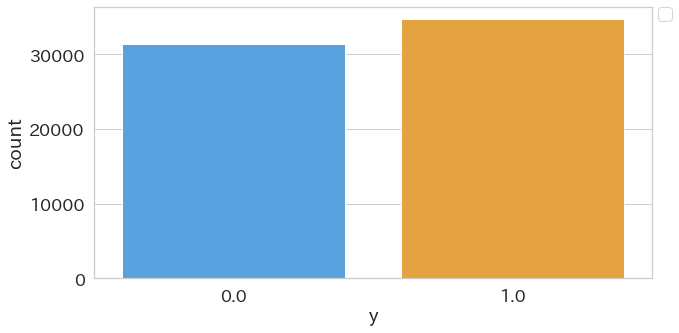

In [22]:
countplot(all_df, "y")

No handles with labels found to put in legend.


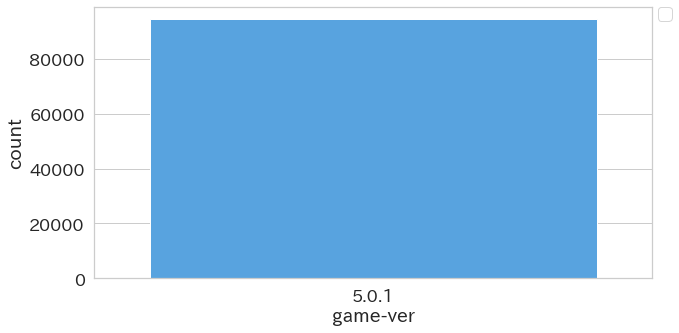

In [23]:
countplot(all_df, "game-ver")

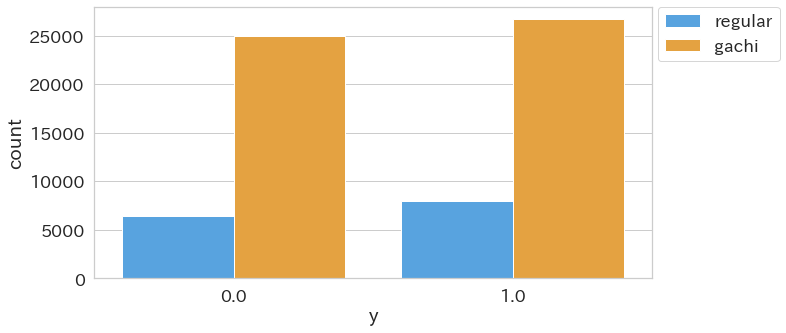

In [24]:
countplot(all_df, "y", hue="lobby-mode")

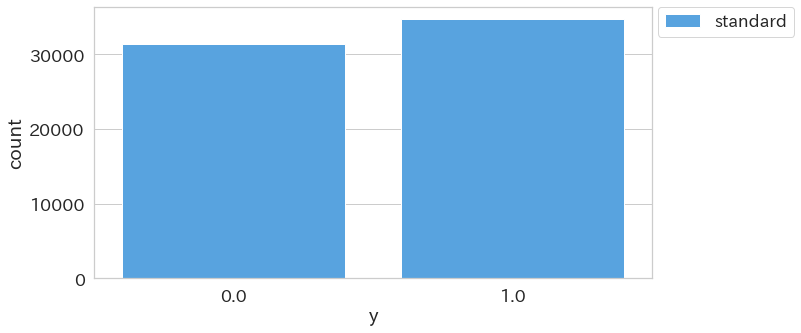

In [25]:
countplot(all_df, "y", hue="lobby")

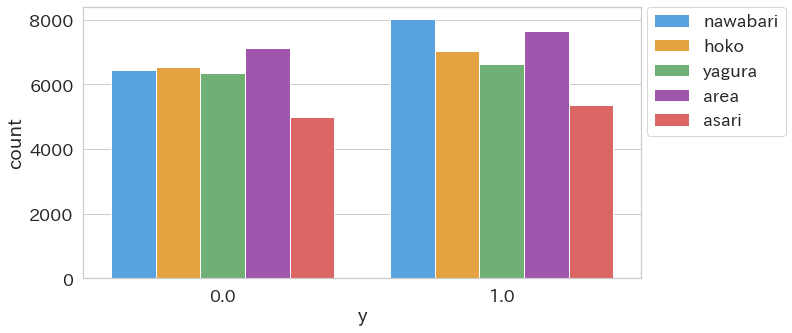

In [26]:
countplot(all_df, "y", hue="mode")

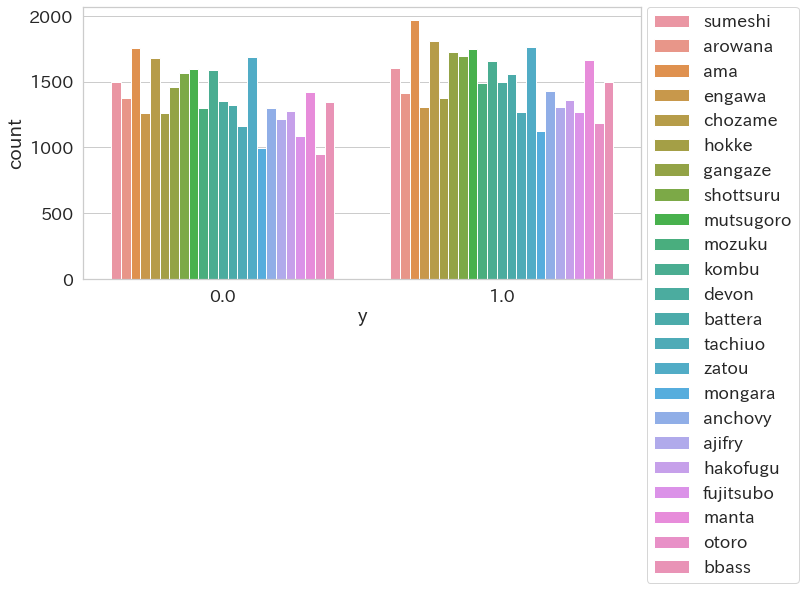

In [27]:
countplot(all_df, "y", hue="stage")

In [28]:
all_df.groupby(["lobby-mode", "y"])[["A-level", "B-level"]].agg(["min", "max", "mean"])

A-level                     B-level                    
                   min     max        mean     min     max        mean
lobby-mode y                                                          
gachi      0.0    43.0  1995.0  714.916226    50.0  2152.0  667.904606
           1.0    46.0  2087.0  719.881738    46.0  1910.0  657.220441
regular    0.0    19.0  1818.0  502.196670    20.0  1780.0  492.521225
           1.0    24.0  1947.0  526.233238    10.0  1627.0  449.814570

In [29]:
display(pd.crosstab([all_df["A-rank"], all_df["B-rank"]], all_df["y"]) \
        .sort_values(by=1.0, ascending=False) \
        .head(10))
display(pd.crosstab([all_df["A-rank"], all_df["B-rank"]], all_df["y"]) \
        .sort_values(by=0.0, ascending=False) \
        .head(10))

y                          0.0    1.0
A-rank      B-rank                   
x_x_x_x     x_x_x_x      11893  12791
s+_s+_s+_s+ s+_s+_s+_s+   6505   6711
s_s_s_s     s_s_s_s       2560   2595
a+_a+_a+_a+ a+_a+_a+_a+     59     66
a-_a-_a-_a- a-_a-_a-_a-     49     58
a+_a+_a+_a+ a+_a+_a_a+      16     31
            a+_a+_a+_a      21     26
a+_a_a+_a+  a+_a+_a+_a+     24     25
a_a+_a+_a+  a+_a+_a+_a+     16     20
a+_a+_a+_a  a+_a+_a+_a+     16     20

,y,0.0,1.0
A-rank,B-rank,,
x_x_x_x,x_x_x_x,11893,12791
s+_s+_s+_s+,s+_s+_s+_s+,6505,6711
s_s_s_s,s_s_s_s,2560,2595
a+_a+_a+_a+,a+_a+_a+_a+,59,66
a-_a-_a-_a-,a-_a-_a-_a-,49,58
a+_a_a+_a+,a+_a+_a+_a+,24,25
a-_a-_a-_a-,a-_a-_a_a-,21,12
a+_a+_a+_a+,a+_a+_a+_a,21,26
a-_a-_a-_a-,a-_a_a-_a-,20,15


In [30]:
display(pd.crosstab([all_df["A-category1"], all_df["B-category1"]], all_df["y"]) \
        .sort_values(by=1.0, ascending=False) \
        .head(10))
display(pd.crosstab([all_df["A-category1"], all_df["B-category1"]], all_df["y"]) \
        .sort_values(by=0.0, ascending=False) \
        .head(10))

y                                                                0.0  1.0
A-category1                     B-category1                              
shooter_shooter_shooter_shooter shooter_shooter_shooter_shooter  562  659
                                shooter_shooter_shooter_roller   156  156
shooter_shooter_shooter_roller  shooter_shooter_shooter_shooter  166  150
shooter_roller_shooter_shooter  shooter_shooter_shooter_shooter  108  141
shooter_shooter_roller_shooter  shooter_shooter_shooter_shooter  123  140
shooter_shooter_shooter_shooter shooter_shooter_roller_shooter   125  140
                                shooter_shooter_shooter_charger  102  139
                                roller_shooter_shooter_shooter   103  133
                                shooter_shooter_charger_shooter   75  122
                                shooter_roller_shooter_shooter   123  112

y                                                                0.0  1.0
A-category1                     B-category1                              
shooter_shooter_shooter_shooter shooter_shooter_shooter_shooter  562  659
shooter_shooter_shooter_roller  shooter_shooter_shooter_shooter  166  150
shooter_shooter_shooter_shooter shooter_shooter_shooter_roller   156  156
shooter_shooter_shooter_charger shooter_shooter_shooter_shooter  146  100
shooter_shooter_shooter_shooter shooter_shooter_roller_shooter   125  140
                                shooter_roller_shooter_shooter   123  112
shooter_shooter_roller_shooter  shooter_shooter_shooter_shooter  123  140
shooter_roller_shooter_shooter  shooter_shooter_shooter_shooter  108  141
shooter_shooter_shooter_shooter roller_shooter_shooter_shooter   103  133
                                shooter_shooter_shooter_charger  102  139

In [31]:
display(pd.crosstab([all_df["A-category2"], all_df["B-category2"]], all_df["y"]) \
        .sort_values(by=1.0, ascending=False) \
        .head(10))
display(pd.crosstab([all_df["A-category2"], all_df["B-category2"]], all_df["y"]) \
        .sort_values(by=0.0, ascending=False) \
        .head(10))

y                                                                  0.0  1.0
A-category2                      B-category2                               
shooter_shooter_shooter_shooter  shooter_shooter_shooter_shooter    21   36
                                 shooter_shooter_maneuver_shooter    7   15
shooter_maneuver_shooter_shooter shooter_shooter_shooter_shooter     3   13
shooter_shooter_shooter_shooter  shooter_shooter_shooter_maneuver    7   11
                                 shooter_shooter_roller_shooter      4   10
shooter_shooter_maneuver_shooter shooter_shooter_maneuver_shooter    0   10
shooter_maneuver_shooter_shooter shooter_shooter_shooter_charger     3    9
shooter_shooter_slosher_shooter  shooter_shooter_shooter_shooter     2    9
shooter_shooter_shooter_shooter  shooter_shooter_slosher_shooter     4    8
shooter_shooter_shooter_maneuver shooter_shooter_shooter_maneuver    3    8

y                                                                   0.0  1.0
A-category2                       B-category2                               
shooter_shooter_shooter_shooter   shooter_shooter_shooter_shooter    21   36
shooter_shooter_shooter_charger   shooter_shooter_shooter_shooter    17    4
shooter_shooter_maneuver_shooter  shooter_shooter_shooter_shooter    12    6
splatling_shooter_shooter_shooter shooter_shooter_shooter_shooter    11    6
shooter_shooter_shooter_shooter   shooter_shooter_shooter_charger     9    6
                                  maneuver_shooter_shooter_shooter    9    8
shooter_roller_shooter_shooter    shooter_shooter_shooter_shooter     9    2
maneuver_shooter_shooter_shooter  shooter_shooter_shooter_shooter     8    5
shooter_shooter_shooter_maneuver  maneuver_shooter_shooter_shooter    8    3
shooter_maneuver_shooter_shooter  shooter_shooter_shooter_maneuver    7    1

In [32]:
display(pd.crosstab([all_df["A-subweapon"], all_df["B-subweapon"]], all_df["y"]) \
        .sort_values(by=1.0, ascending=False) \
        .head(10))
display(pd.crosstab([all_df["A-subweapon"], all_df["B-subweapon"]], all_df["y"]) \
        .sort_values(by=0.0, ascending=False) \
        .head(10))

,y,0.0,1.0
A-subweapon,B-subweapon,,
splashbomb_splashbomb_kyubanbomb_splashbomb,robotbomb_curlingbomb_torpedo_splashbomb,0,3
splashbomb_quickbomb_splashbomb_kyubanbomb,quickbomb_splashbomb_splashbomb_splashbomb,0,2
splashbomb_quickbomb_splashbomb_splashbomb,sprinkler_splashbomb_splashbomb_robotbomb,0,2
splashbomb_splashbomb_splashbomb_poisonmist,kyubanbomb_splashbomb_splashbomb_splashbomb,0,2
splashbomb_splashbomb_kyubanbomb_splashbomb,robotbomb_quickbomb_splashshield_robotbomb,0,2
splashbomb_jumpbeacon_curlingbomb_splashbomb,splashbomb_splashbomb_pointsensor_splashbomb,0,2
curlingbomb_splashbomb_splashbomb_quickbomb,splashbomb_curlingbomb_splashbomb_splashbomb,0,2
jumpbeacon_splashbomb_curlingbomb_splashbomb,curlingbomb_splashbomb_kyubanbomb_curlingbomb,0,2
splashbomb_splashbomb_curlingbomb_quickbomb,splashshield_robotbomb_curlingbomb_curlingbomb,0,2


,y,0.0,1.0
A-subweapon,B-subweapon,,
sprinkler_splashbomb_curlingbomb_splashshield,splashbomb_splashbomb_splashbomb_curlingbomb,2,0
splashbomb_quickbomb_splashbomb_splashbomb,splashbomb_poisonmist_robotbomb_splashbomb,2,0
jumpbeacon_splashbomb_pointsensor_splashbomb,splashbomb_splashbomb_kyubanbomb_splashbomb,2,0
splashbomb_splashbomb_pointsensor_curlingbomb,curlingbomb_curlingbomb_splashbomb_splashbomb,2,0
robotbomb_splashbomb_kyubanbomb_trap,curlingbomb_pointsensor_splashbomb_splashbomb,2,0
splashbomb_splashbomb_splashbomb_curlingbomb,splashbomb_kyubanbomb_curlingbomb_trap,2,0
splashbomb_curlingbomb_kyubanbomb_splashbomb,splashbomb_pointsensor_splashbomb_curlingbomb,2,0
curlingbomb_splashbomb_splashbomb_sprinkler,curlingbomb_curlingbomb_curlingbomb_curlingbomb,2,0
splashbomb_splashbomb_quickbomb_splashbomb,splashbomb_kyubanbomb_kyubanbomb_splashbomb,2,0


In [33]:
display(pd.crosstab([all_df["A-special"], all_df["B-special"]], all_df["y"]) \
        .sort_values(by=1.0, ascending=False) \
        .head(10))
display(pd.crosstab([all_df["A-special"], all_df["B-special"]], all_df["y"]) \
        .sort_values(by=0.0, ascending=False) \
        .head(10))

,y,0.0,1.0
A-special,B-special,,
amefurashi_armor_missile_kyubanbomb_pitcher,bubble_nicedama_chakuchi_nicedama,0,2
missile_bubble_missile_armor,nicedama_amefurashi_armor_nicedama,0,2
armor_nicedama_jetpack_splashbomb_pitcher,jetpack_presser_chakuchi_bubble,0,2
missile_sphere_jetpack_sphere,jetpack_armor_chakuchi_sphere,0,2
missile_sphere_amefurashi_sphere,armor_amefurashi_chakuchi_sphere,0,2
missile_armor_sphere_sphere,missile_amefurashi_chakuchi_amefurashi,0,2
nicedama_amefurashi_amefurashi_missile,missile_amefurashi_missile_nicedama,0,2
missile_chakuchi_amefurashi_chakuchi,chakuchi_missile_armor_amefurashi,0,2
amefurashi_amefurashi_sphere_amefurashi,armor_chakuchi_armor_bubble,0,2


,y,0.0,1.0
A-special,B-special,,
nicedama_chakuchi_armor_nicedama,chakuchi_nicedama_nicedama_chakuchi,2,0
missile_missile_amefurashi_missile,missile_nicedama_chakuchi_armor,2,0
armor_armor_amefurashi_ultrahanko,chakuchi_missile_missile_nicedama,2,0
missile_amefurashi_chakuchi_chakuchi,sphere_ultrahanko_amefurashi_armor,2,0
chakuchi_chakuchi_chakuchi_nicedama,amefurashi_missile_chakuchi_sphere,2,0
nicedama_missile_chakuchi_chakuchi,armor_chakuchi_chakuchi_missile,2,0
amefurashi_chakuchi_nicedama_presser,amefurashi_amefurashi_chakuchi_amefurashi,2,0
missile_amefurashi_missile_missile,armor_chakuchi_missile_missile,2,0
armor_bubble_ultrahanko_bubble,ultrahanko_chakuchi_bubble_amefurashi,2,0


In [66]:
(0.61 * all_df.dropna(subset=["y"])["lobby-mode"].value_counts(normalize=True)[1]) + (0.54 * all_df.dropna(subset=["y"])["lobby-mode"].value_counts(normalize=True)[0])

0.5552904347826088

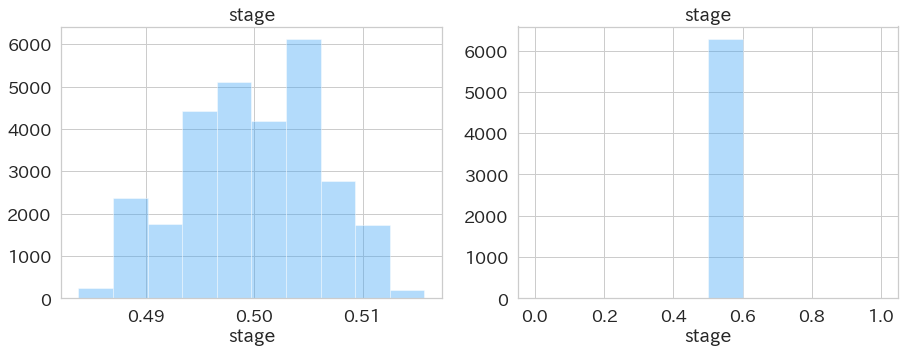

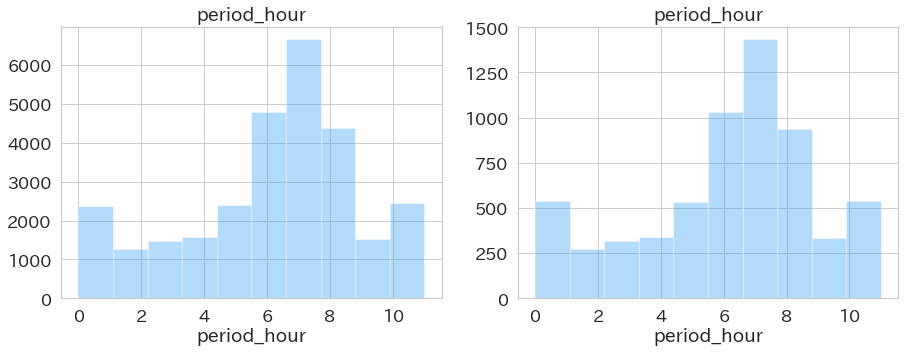

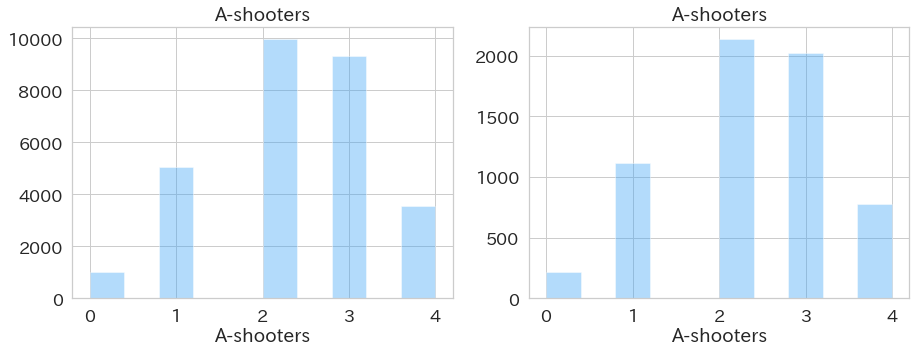

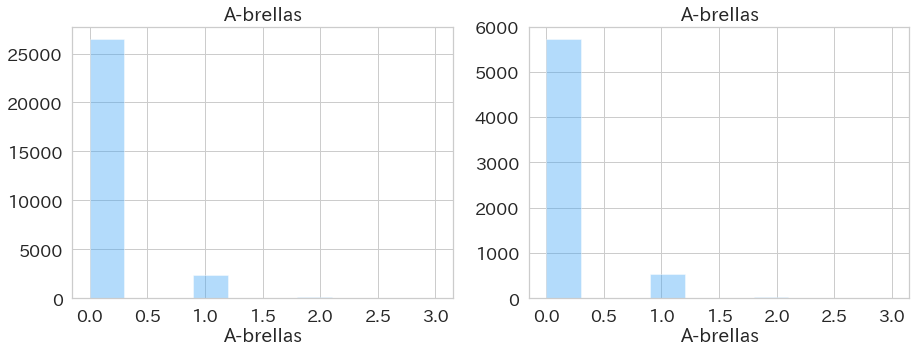

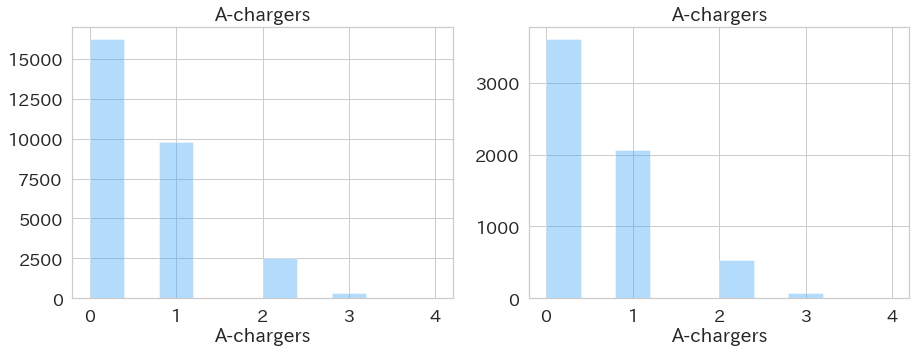

...

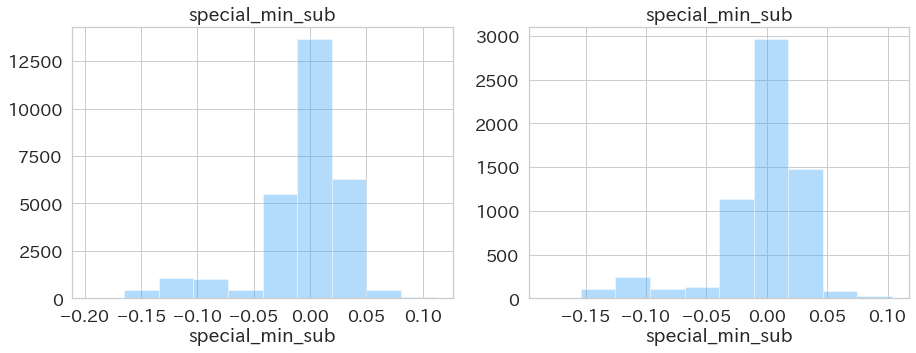

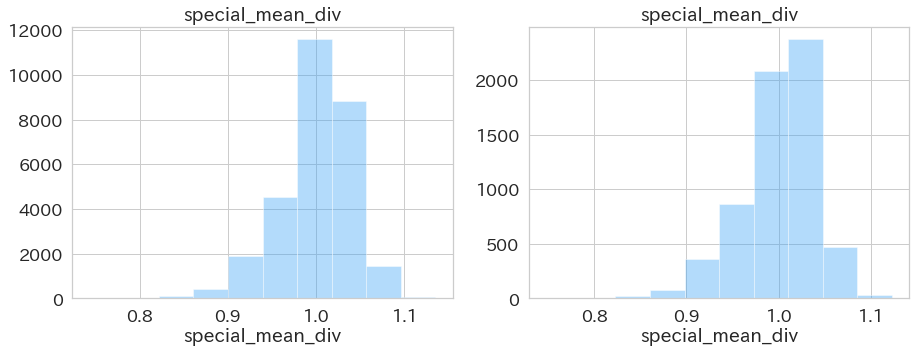

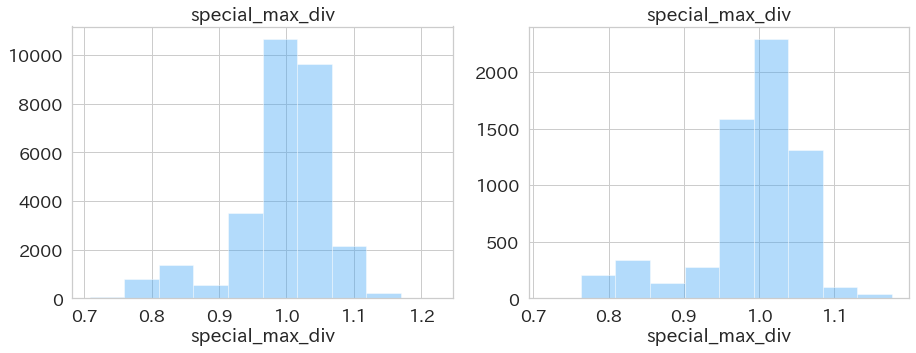

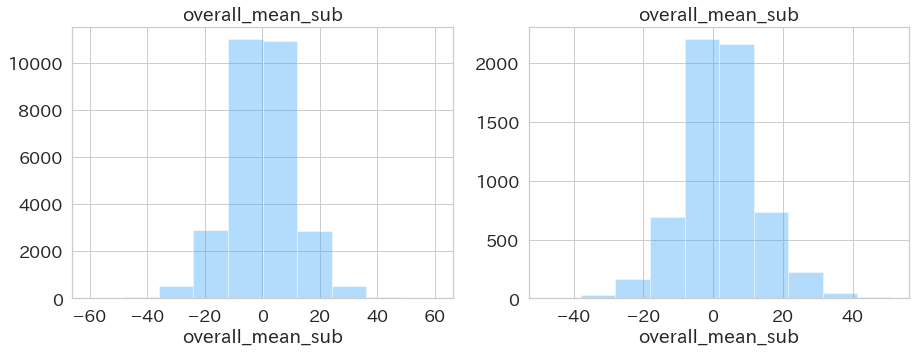

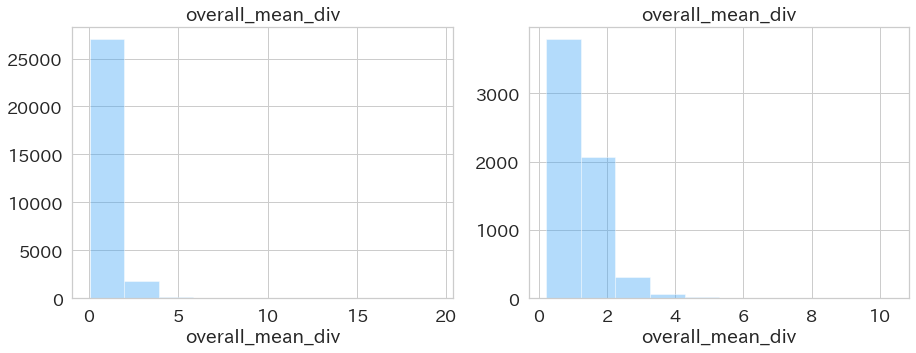

In [15]:
temp = pd.read_csv("case11_double_regular.csv")
for c in temp.columns:
    if c == "y" or c == "id": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

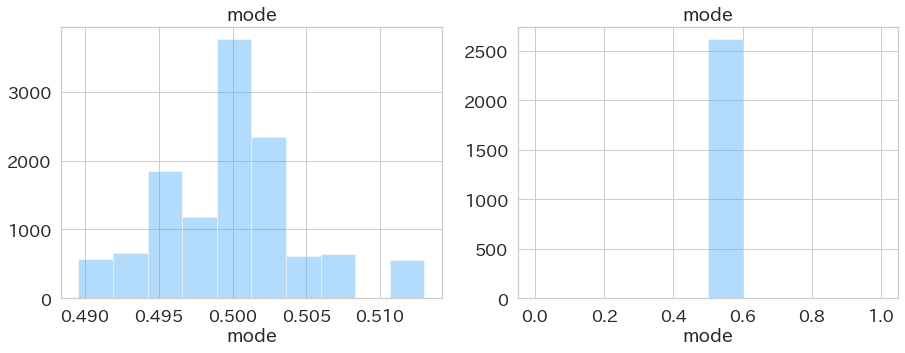

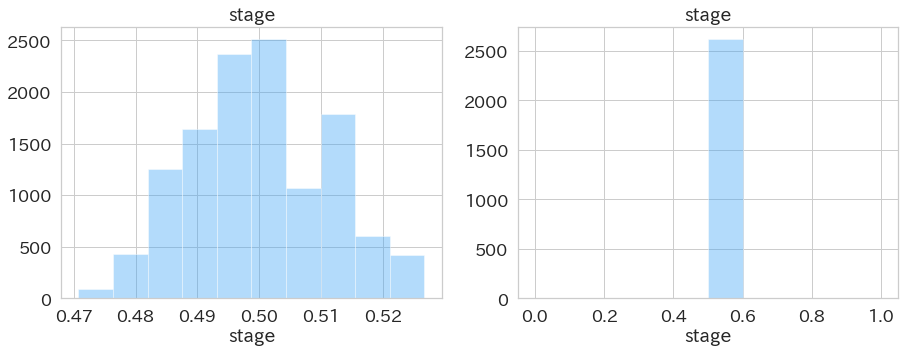

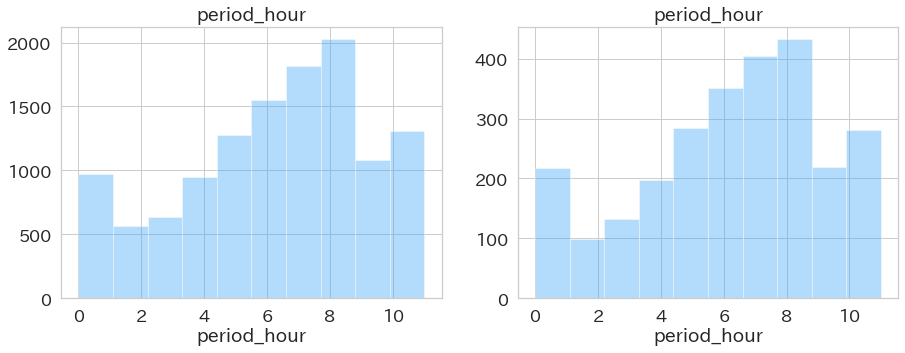

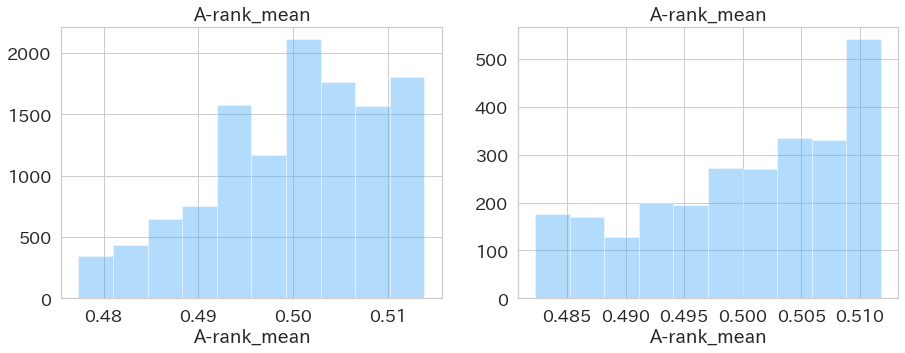

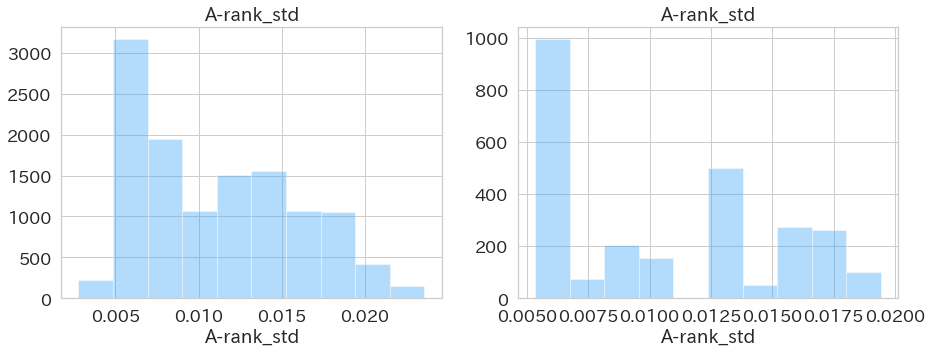

...

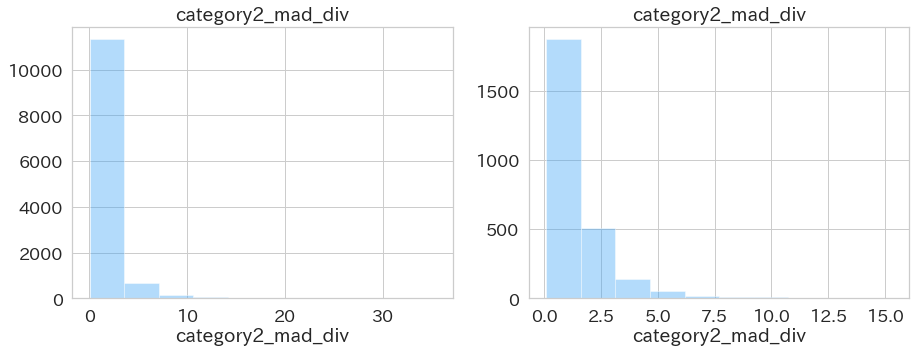

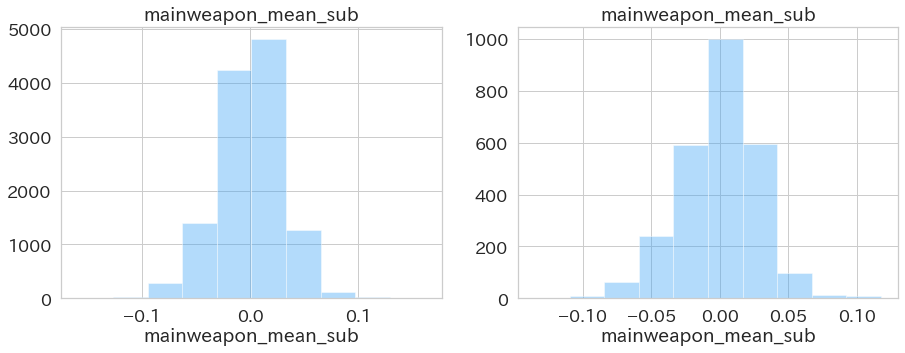

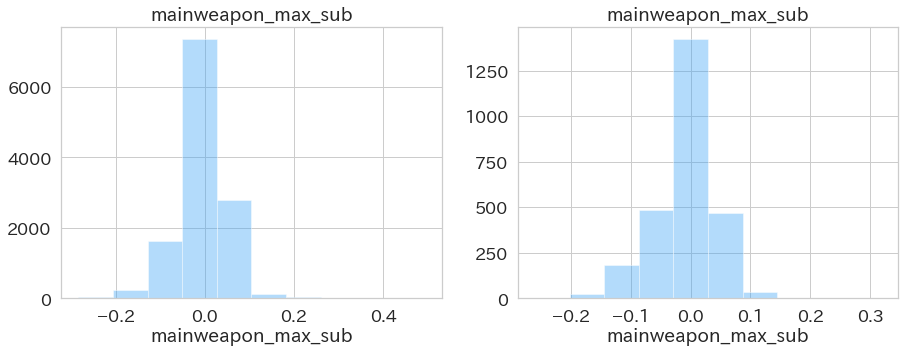

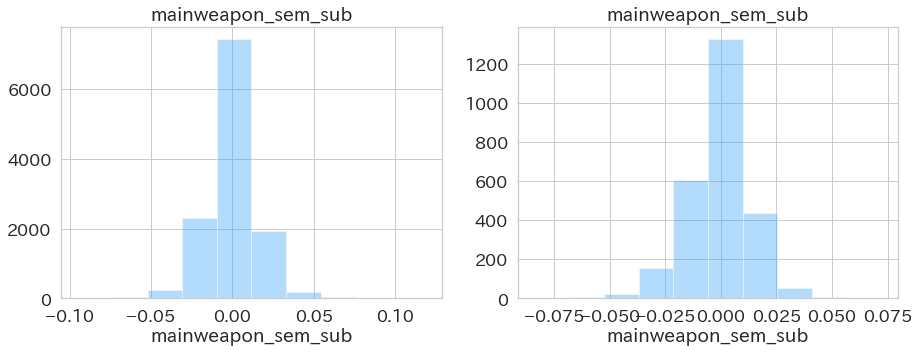

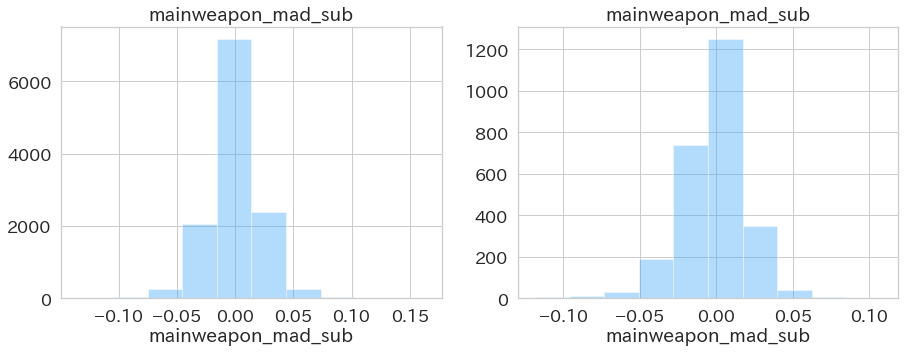

KeyboardInterrupt: 

In [18]:
temp = pd.read_csv("case09_zone_a.csv")
for c in temp.columns:
    if c == "y" or c == "id" or c == "reskin_min_div" or c == "rank_std_div": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

In [17]:
for c in temp[temp.columns[temp.columns.str.contains("mad")]]:
    print(temp[c].value_counts().sort_index())

0.000000      96
0.000115    5204
0.000119    9871
0.000132    5348
0.000133    5305
            ... 
0.065498       2
0.065773       2
0.067874       1
0.068328       2
0.070489       1
Name: A-rank_mad, Length: 1218, dtype: int64
0.375       3
0.500       2
0.750       4
0.875       2
1.000      14
           ..
293.750     1
294.875     1
297.125     1
297.375     1
315.500     1
Name: A-level_mad, Length: 1813, dtype: int64
0.000287    1
0.000293    1
0.000319    1
0.000354    1
0.000359    1
           ..
0.094752    1
0.096213    1
0.097282    1
0.100616    1
0.103087    1
Name: A-weapon_mad, Length: 157966, dtype: int64
0.000551    1
0.000571    2
0.000584    1
0.000614    1
0.000708    1
           ..
0.027868    2
0.028038    6
0.028173    1
0.028323    4
0.028450    9
Name: A-category1_mad, Length: 4982, dtype: int64
0.000141      2
0.000228    124
0.000230     41
0.000263     33
0.000265      8
           ... 
0.033397      1
0.033638      2
0.033751      1
0.033834      2
0

In [6]:
temp["stage"].value_counts()

0.500000    5186
0.498486     425
0.501211     424
0.496689     415
0.497596     412
            ... 
0.484252     120
0.497881     116
0.506329     114
0.495164     111
0.493776     106
Name: stage, Length: 91, dtype: int64

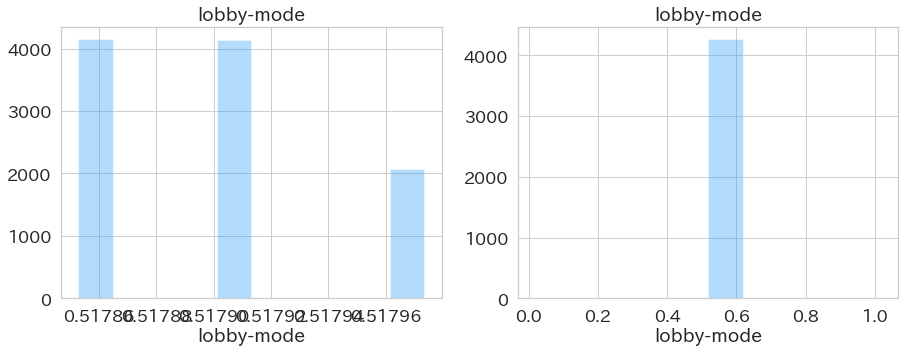

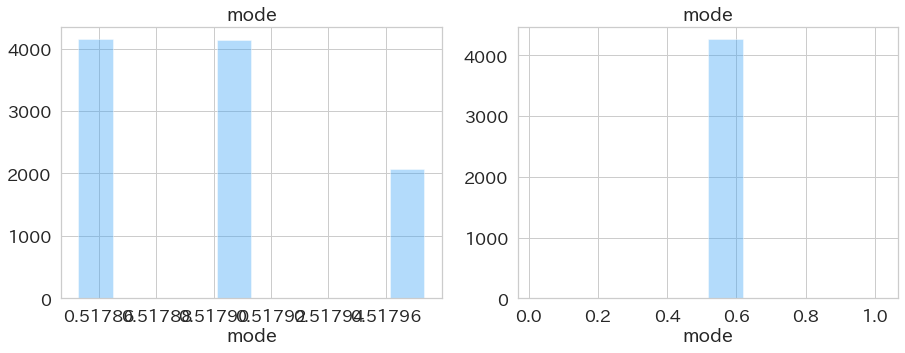

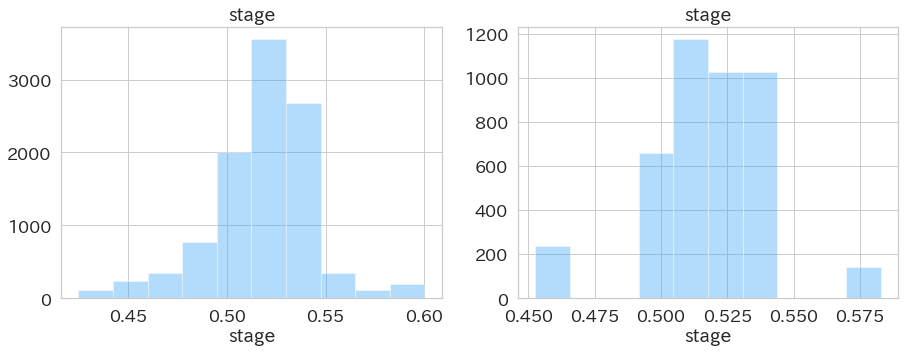

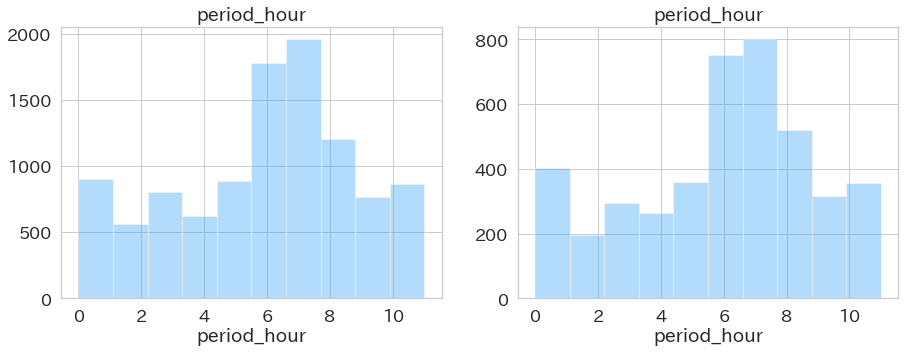

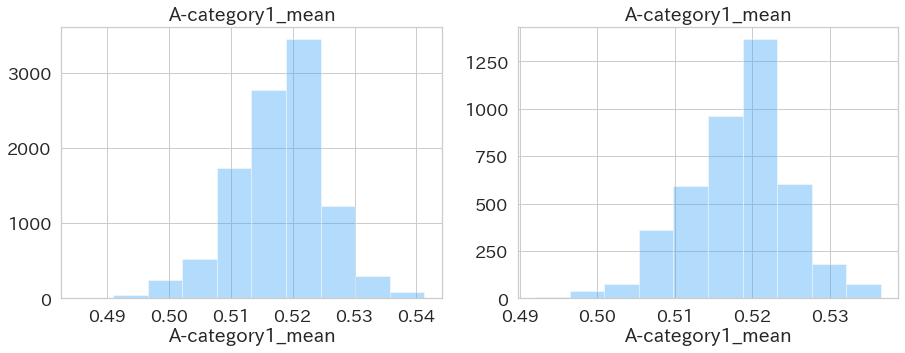

...

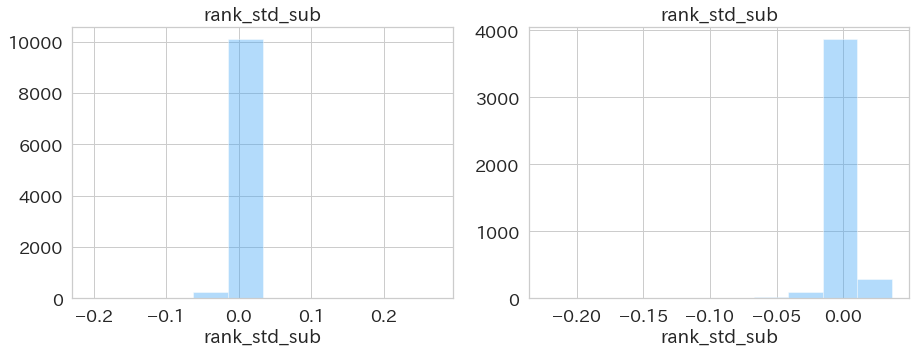

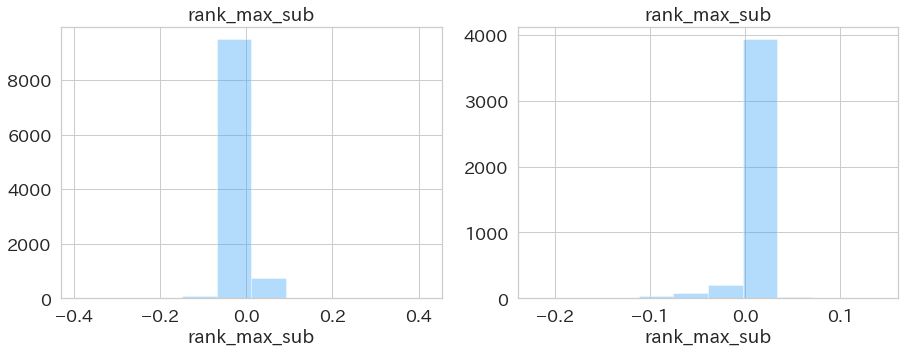

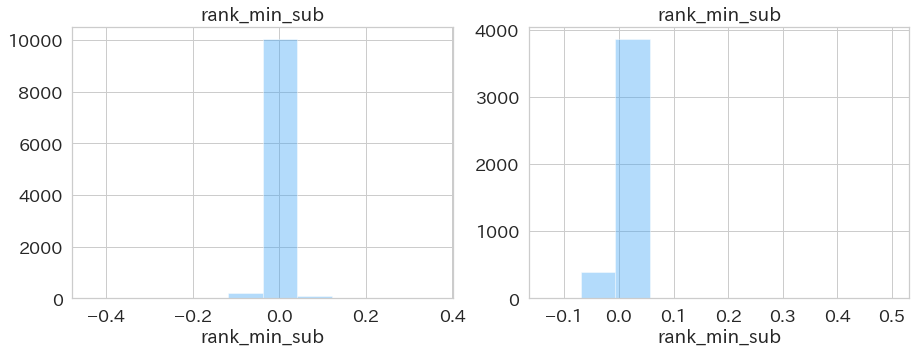

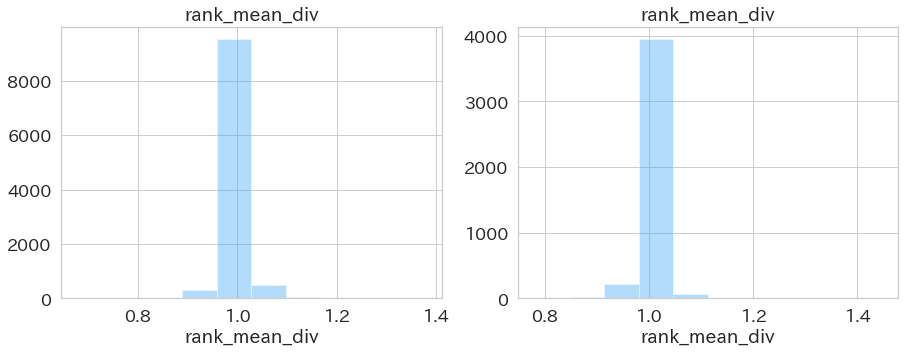

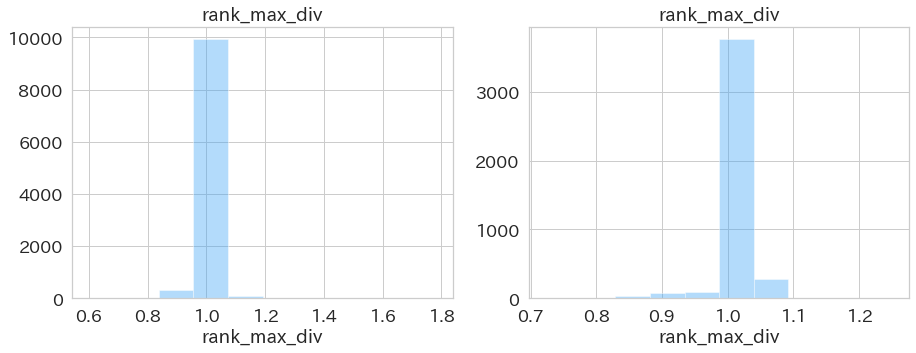

In [53]:
temp = pd.read_csv("case05_multiple_asari.csv")
for c in temp.columns:
    if c == "y" or c == "id" or c == "reskin_min_div" or c == "rank_std_div" or c == "rank_min_div": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

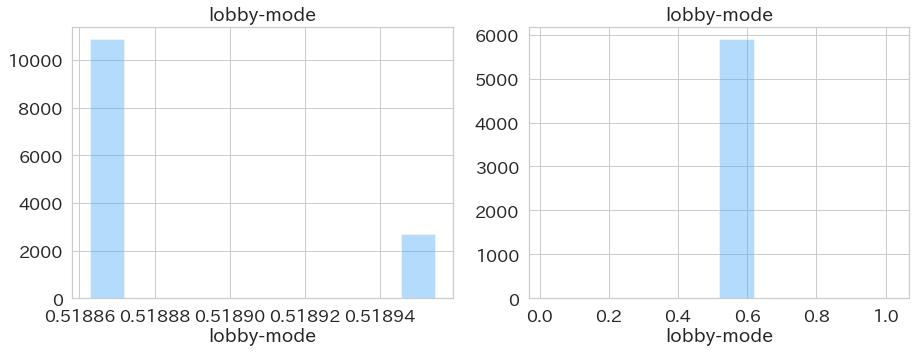

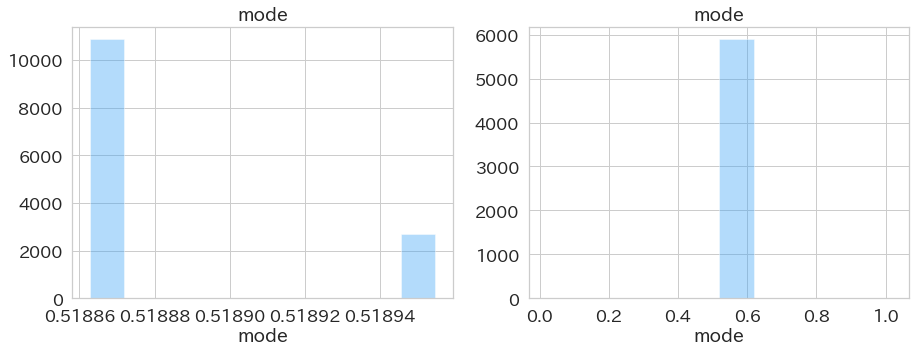

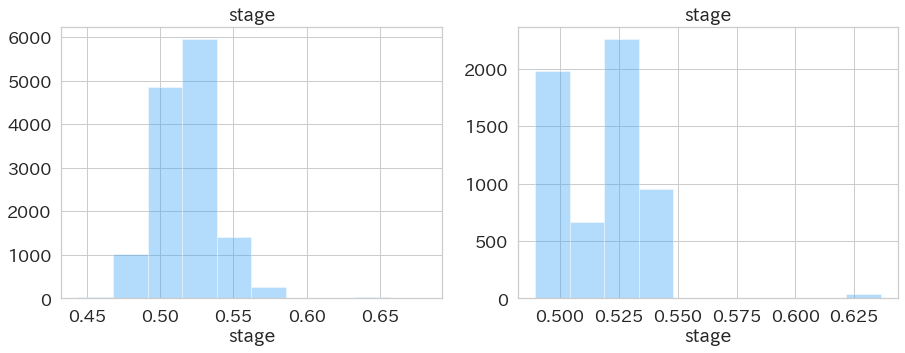

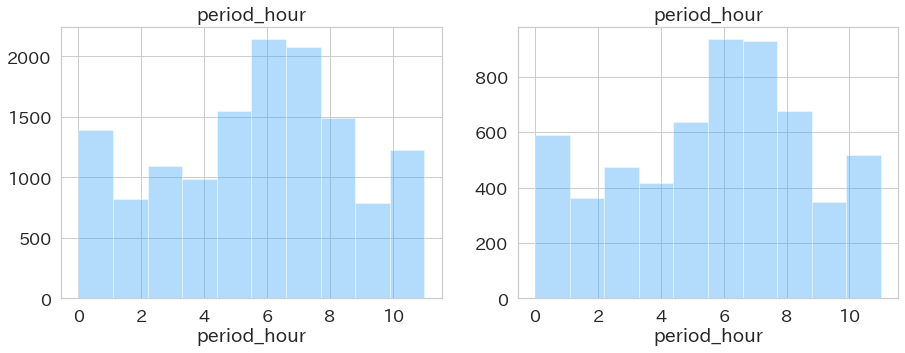

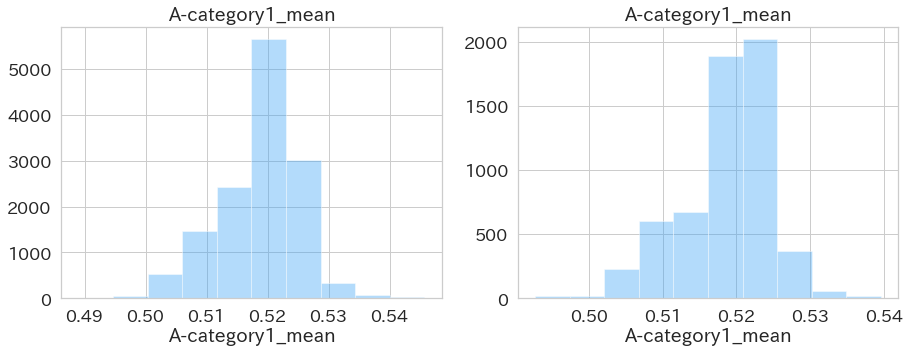

...

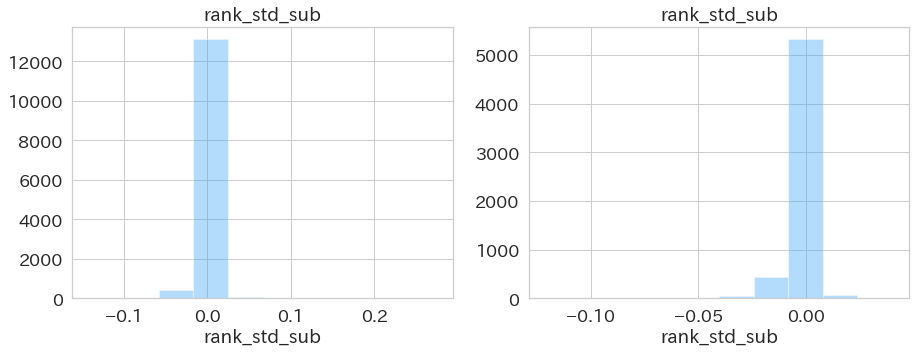

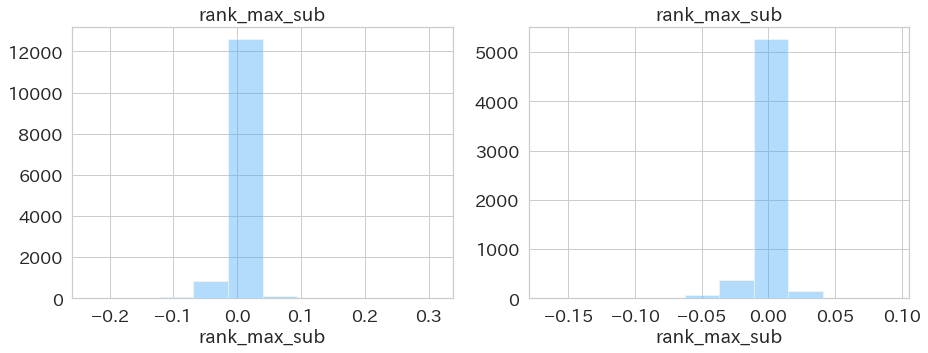

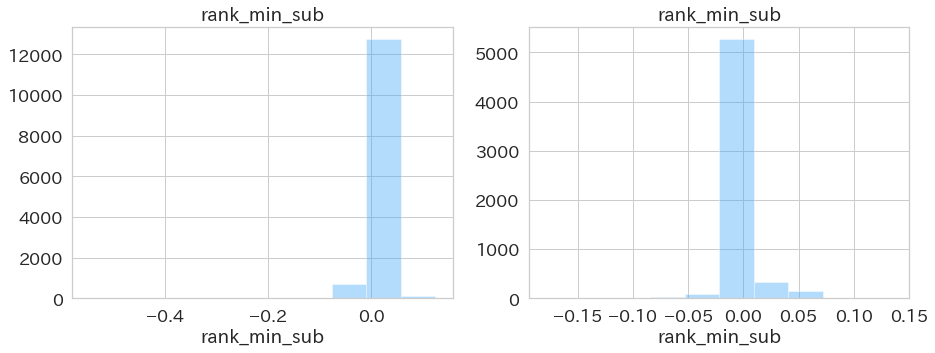

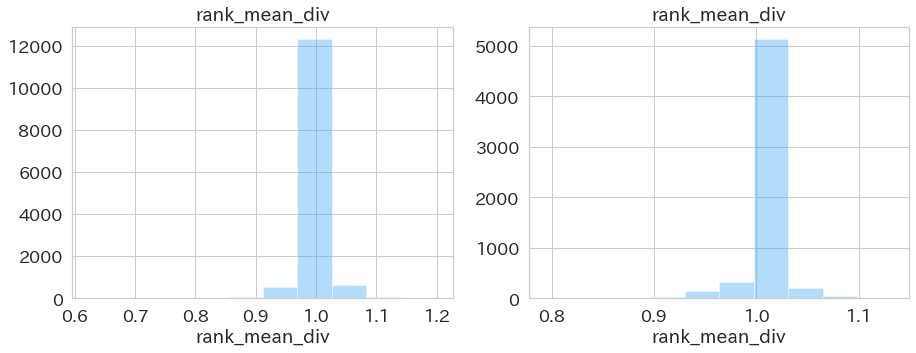

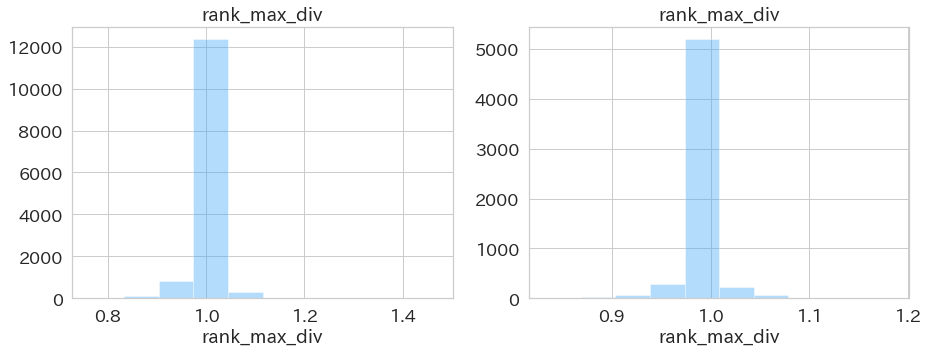

In [54]:
temp = pd.read_csv("case05_multiple_hoko.csv")
for c in temp.columns:
    if c == "y" or c == "id" or c == "reskin_min_div" or c == "rank_std_div" or c == "rank_min_div": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

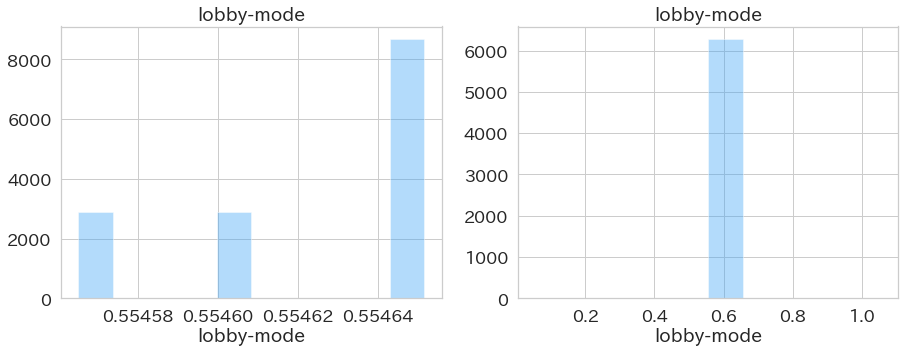

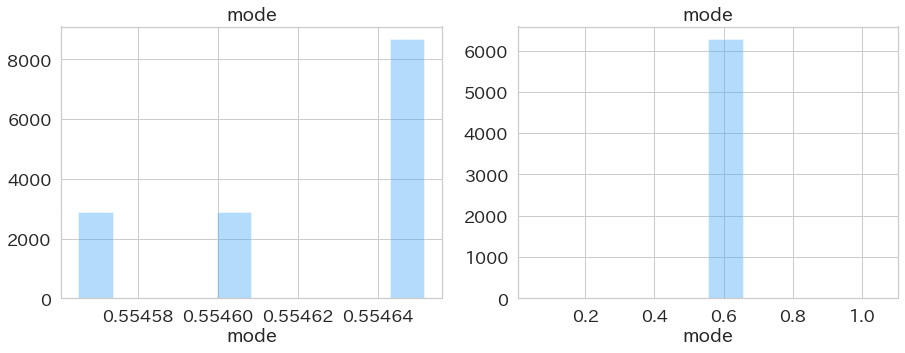

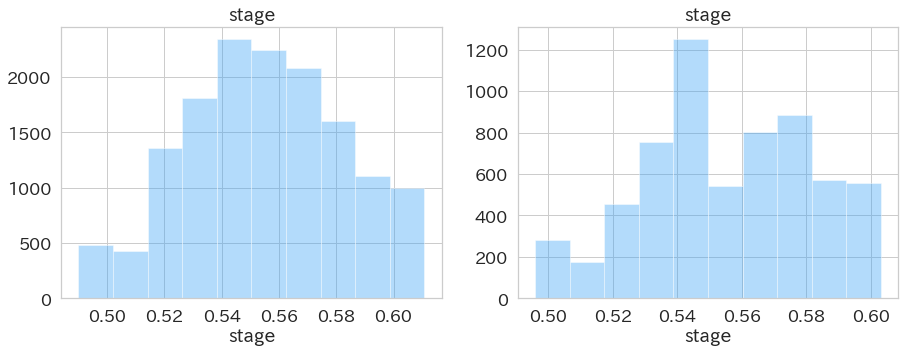

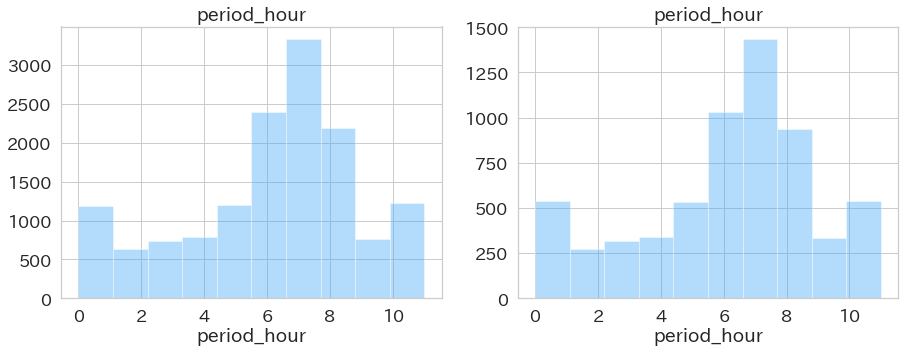

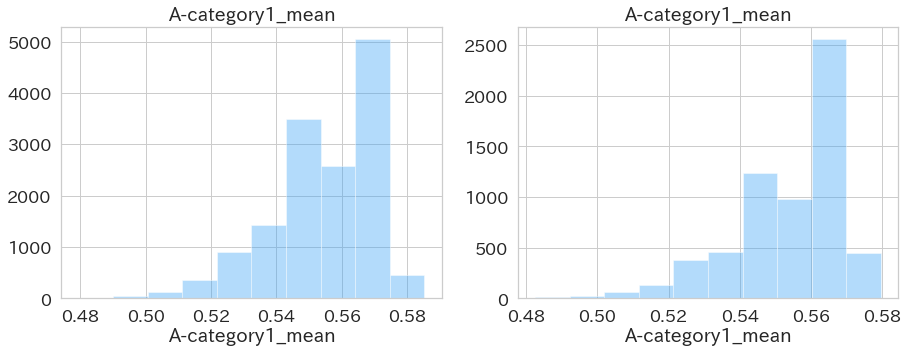

...

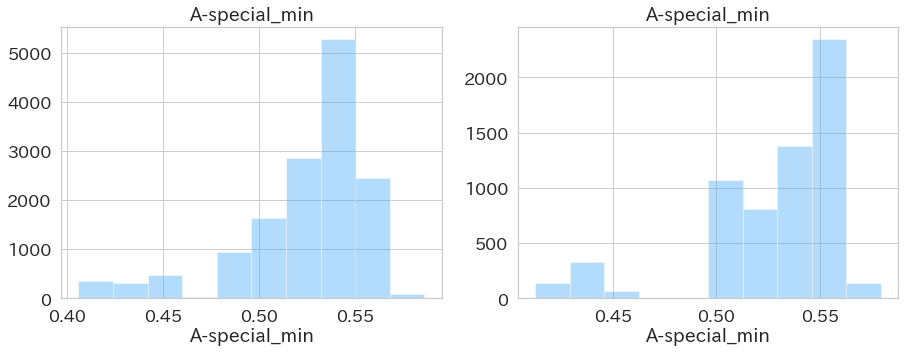

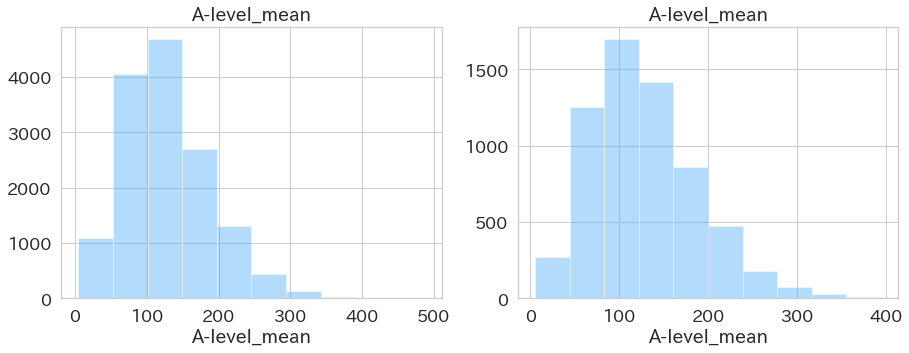

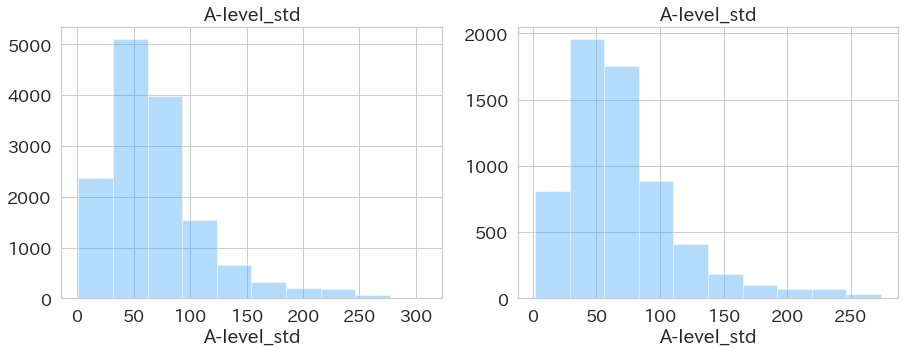

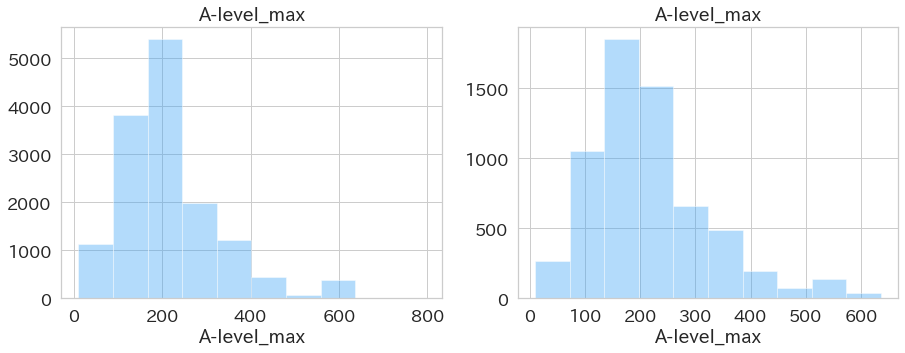

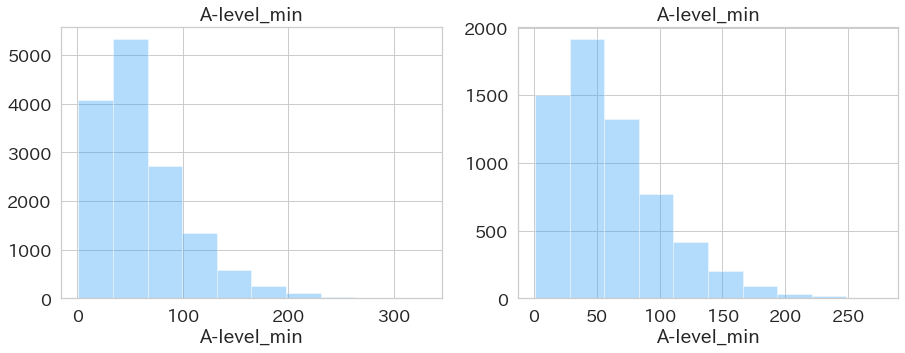

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


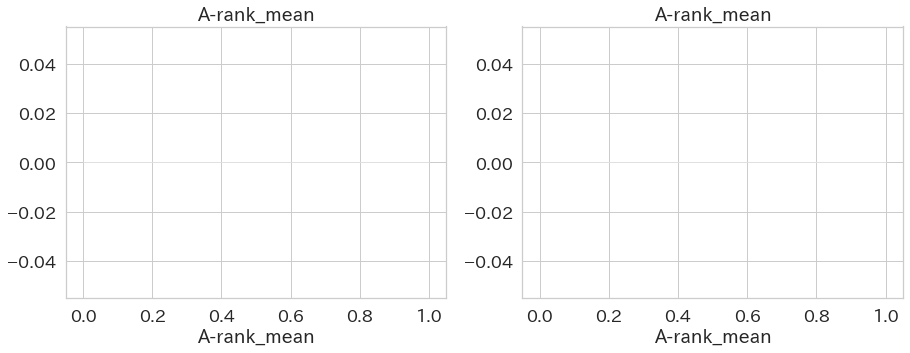

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


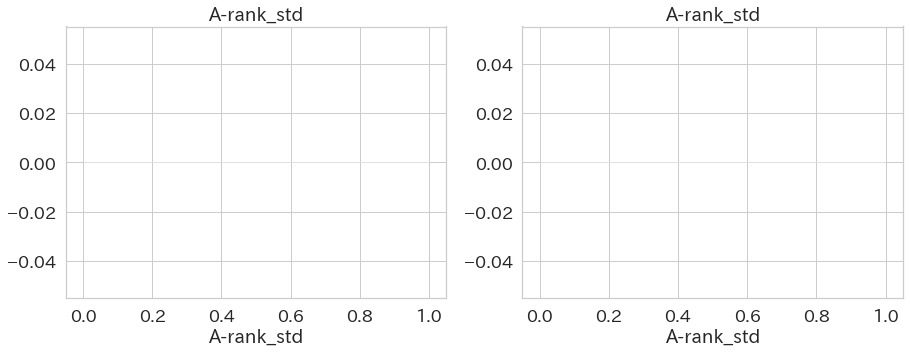

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


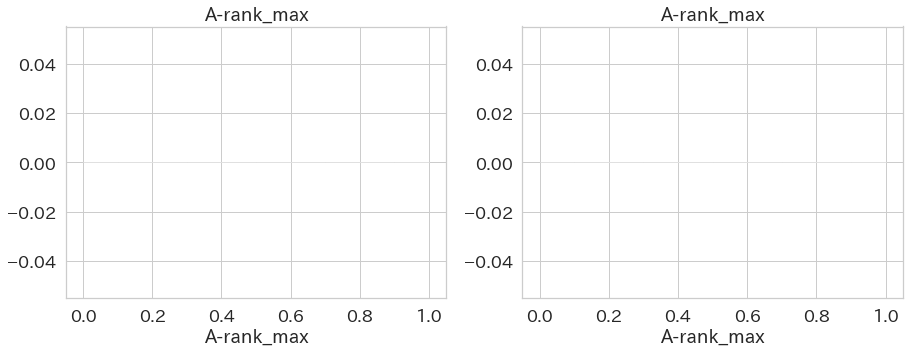

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


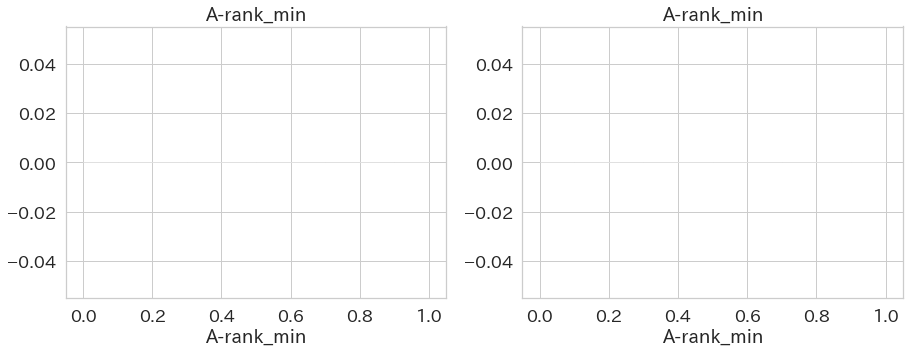

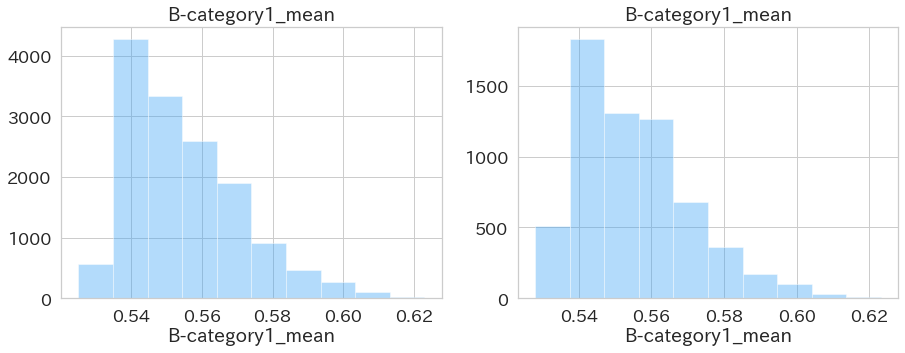

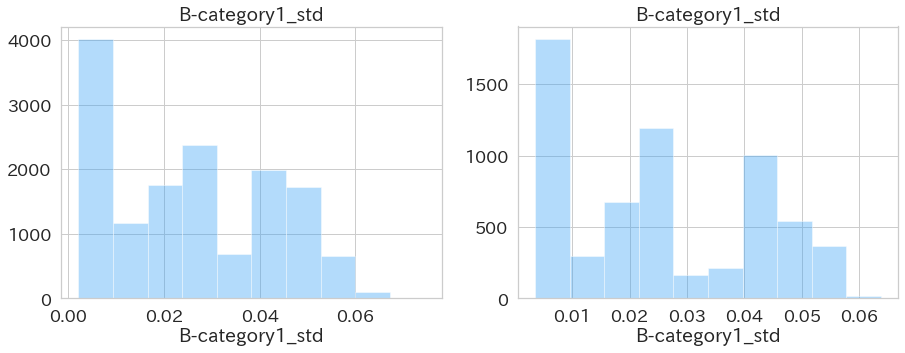

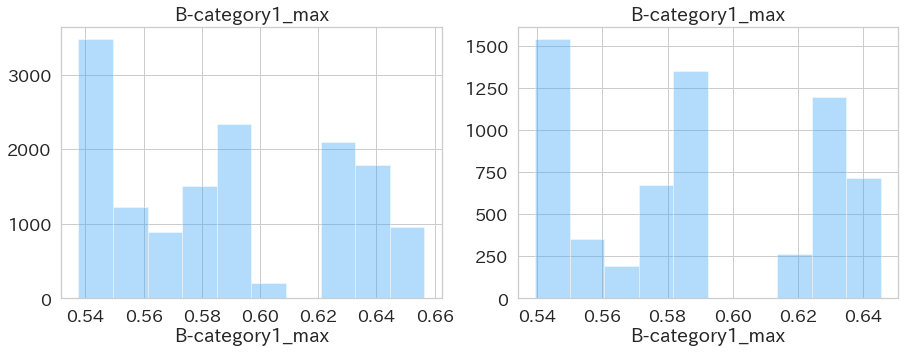

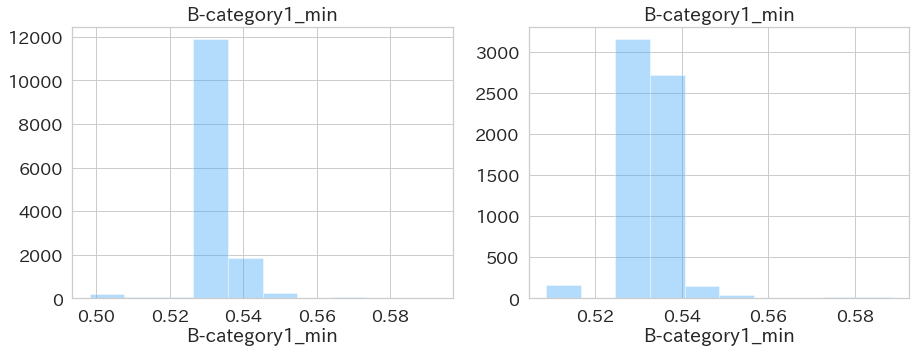

...

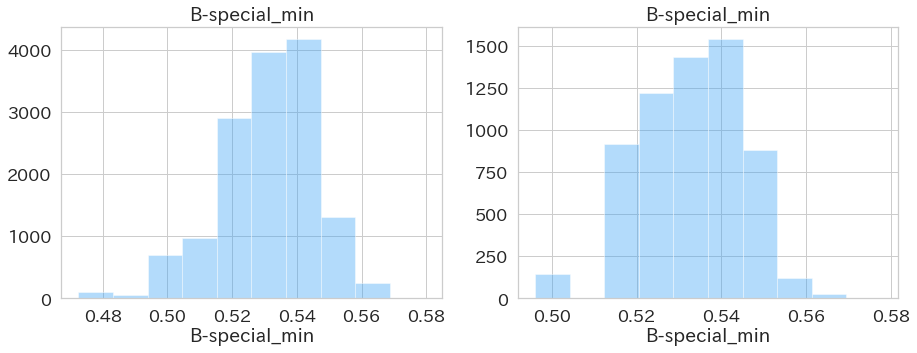

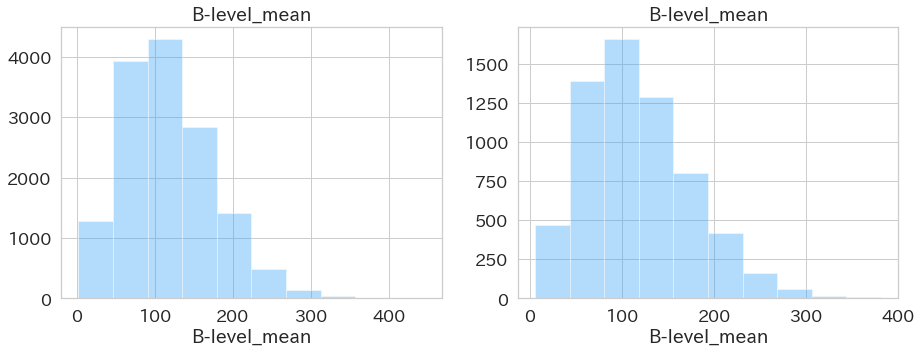

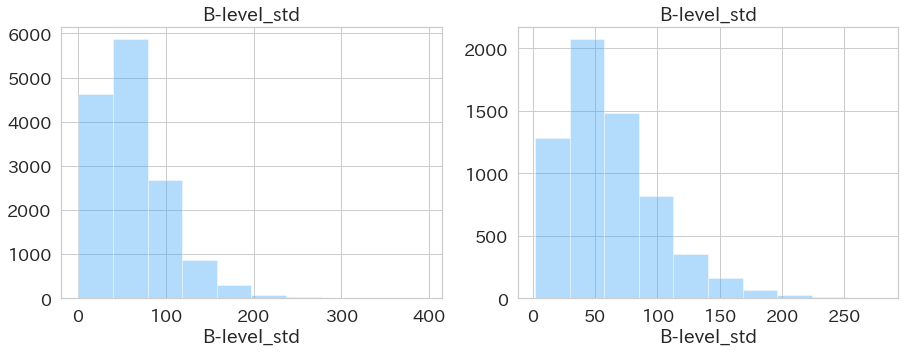

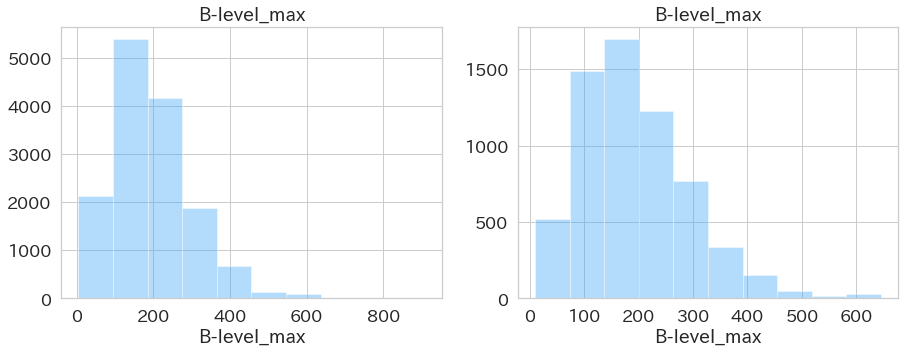

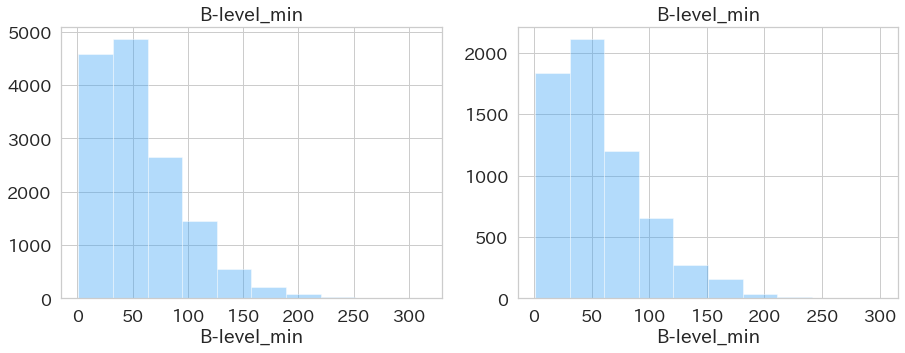

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


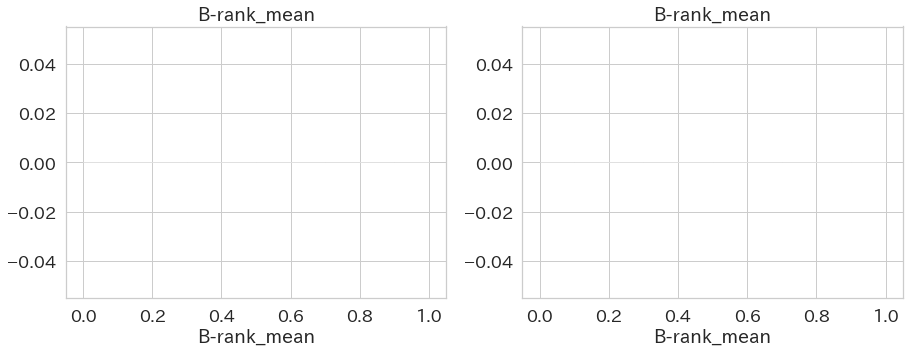

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


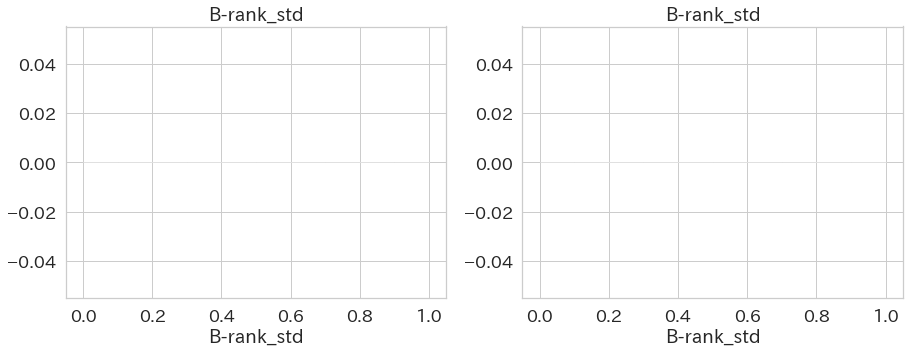

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


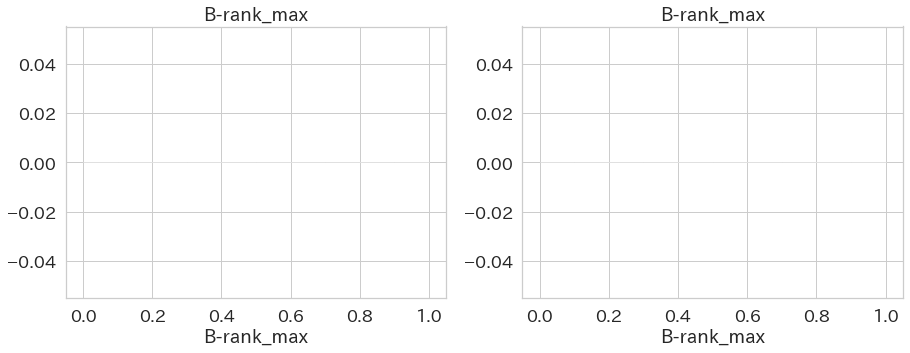

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


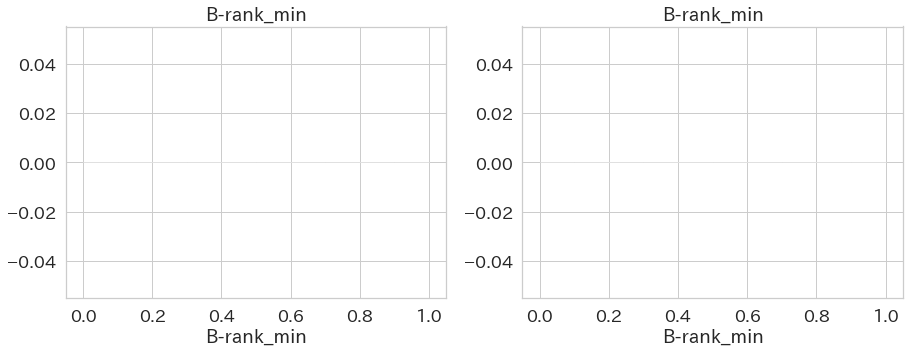

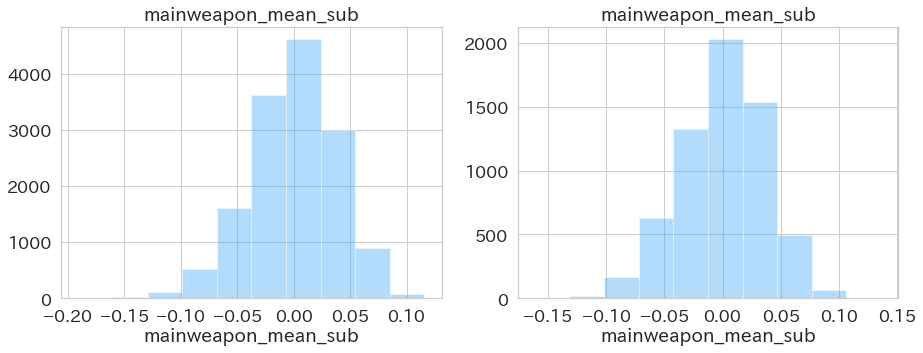

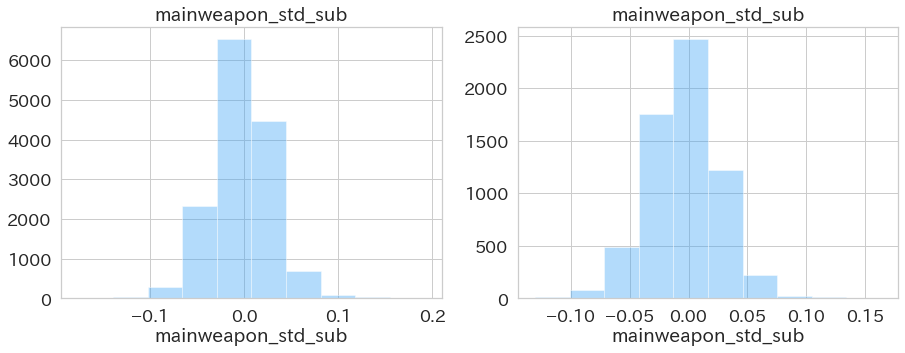

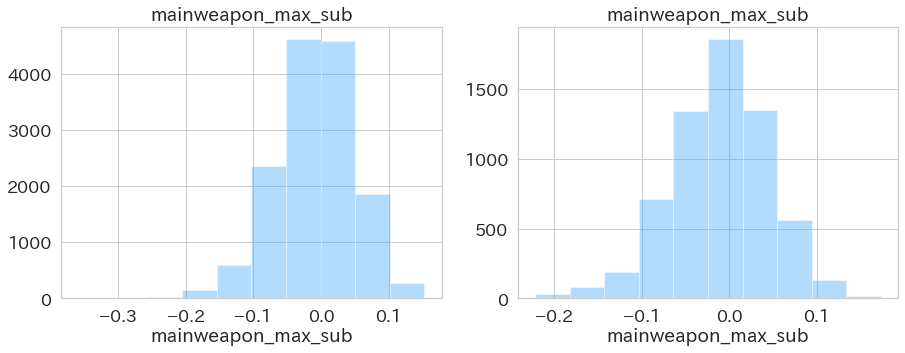

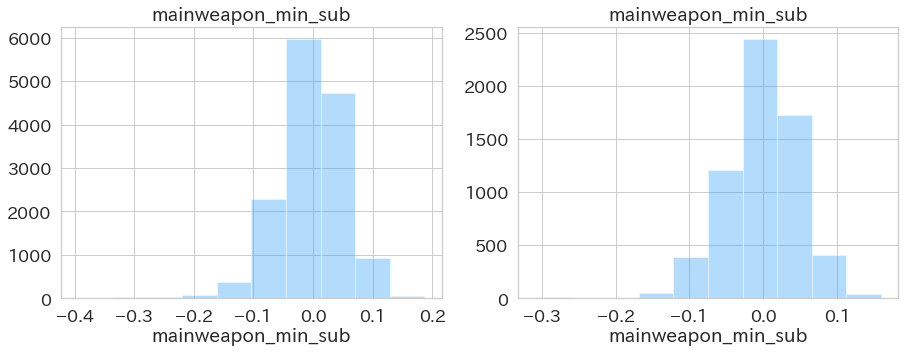

...

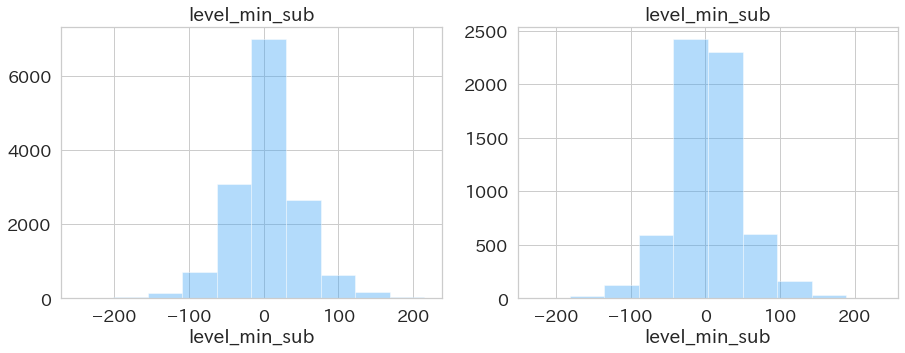

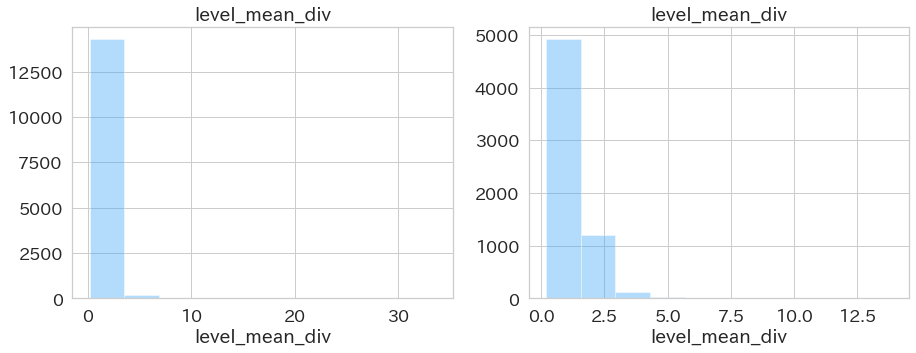

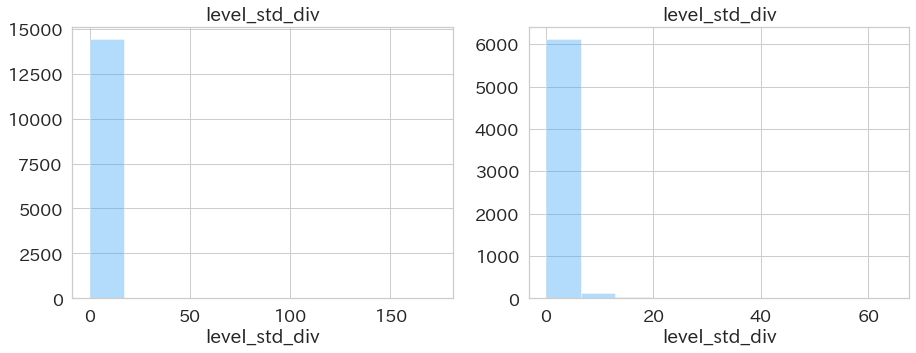

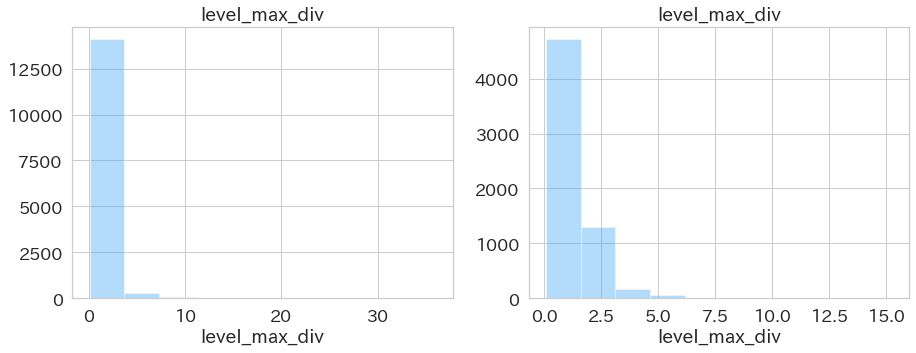

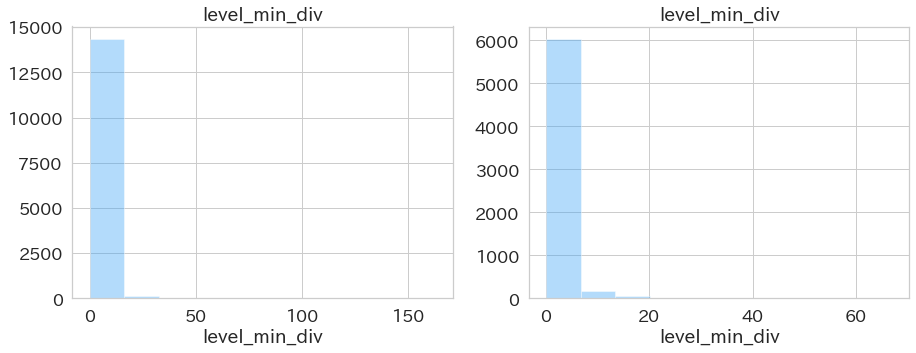

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


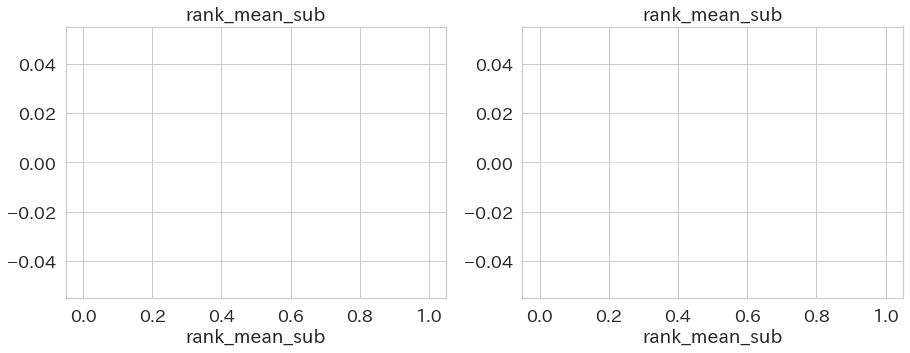

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


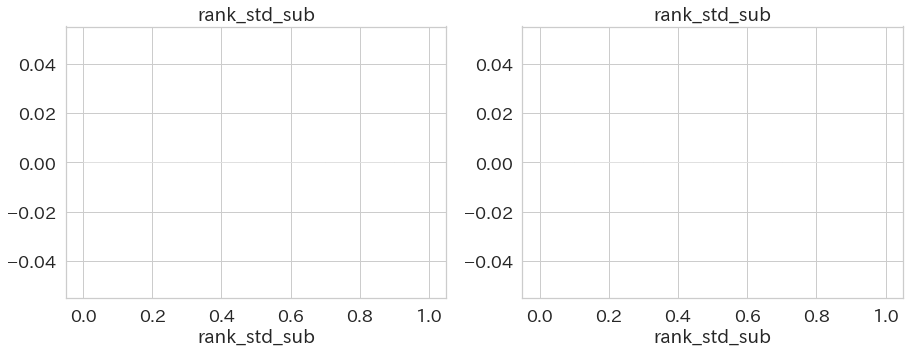

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


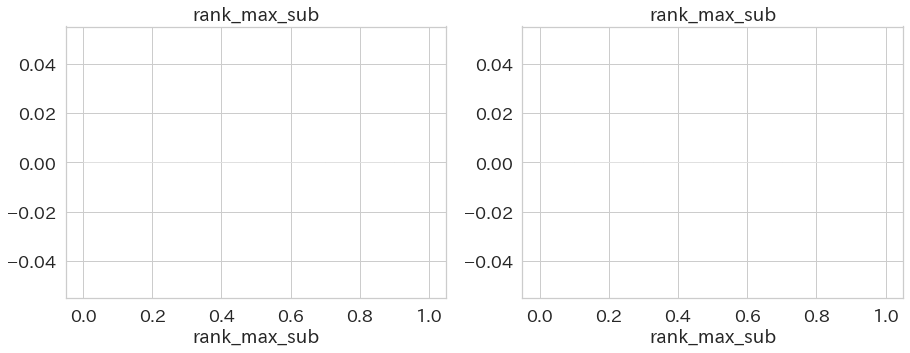

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


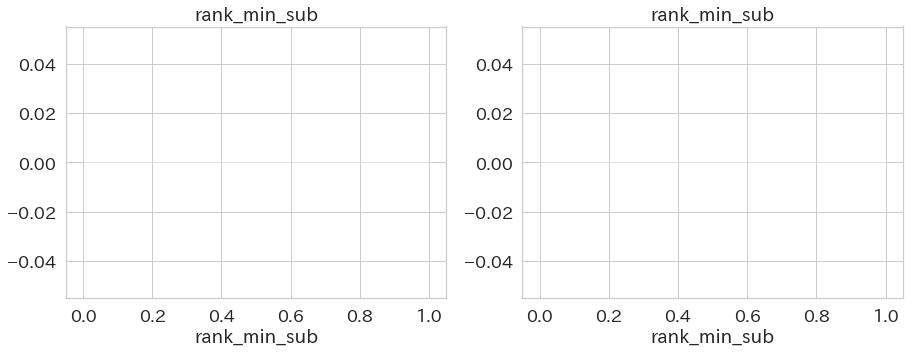

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


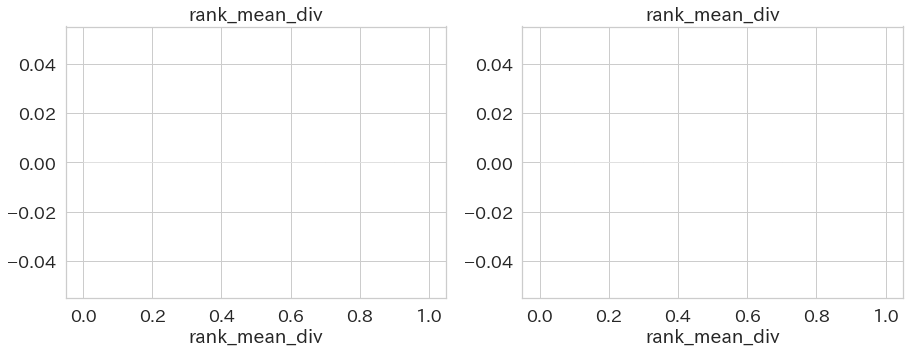

C:\Users\mikan\Anaconda3\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\mikan\Anaconda3\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


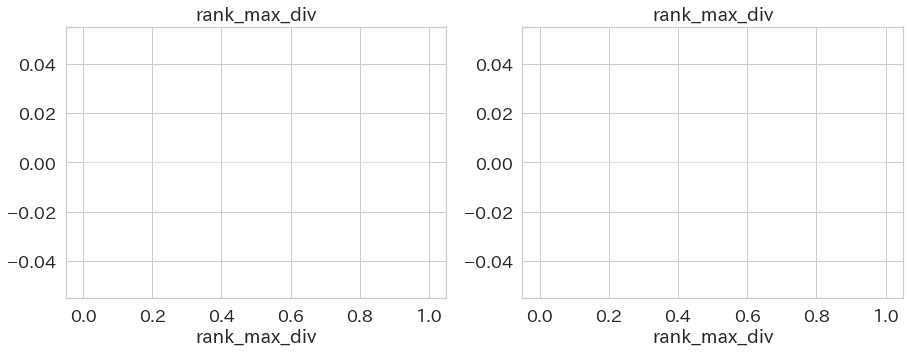

In [55]:
temp = pd.read_csv("case05_multiple_nawabari.csv")
for c in temp.columns:
    if c == "y" or c == "id" or c == "reskin_min_div" or c == "rank_std_div" or c == "rank_min_div": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

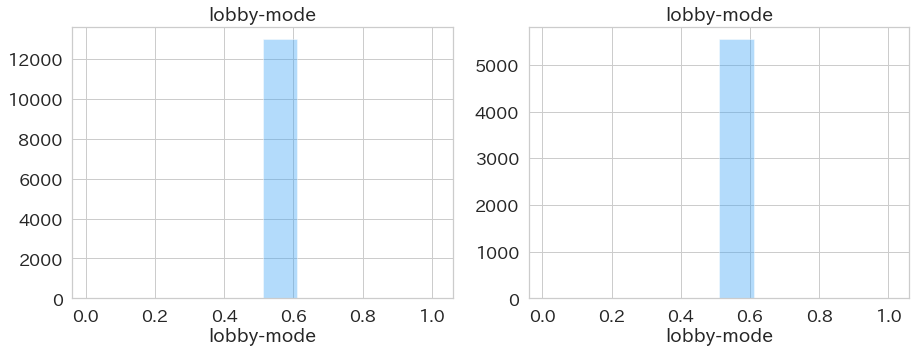

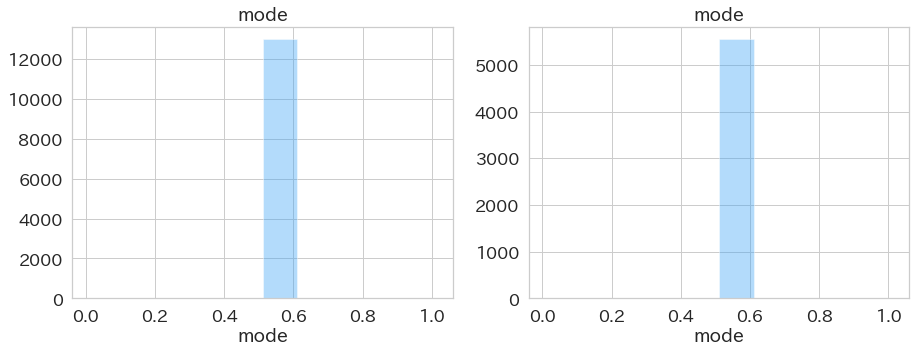

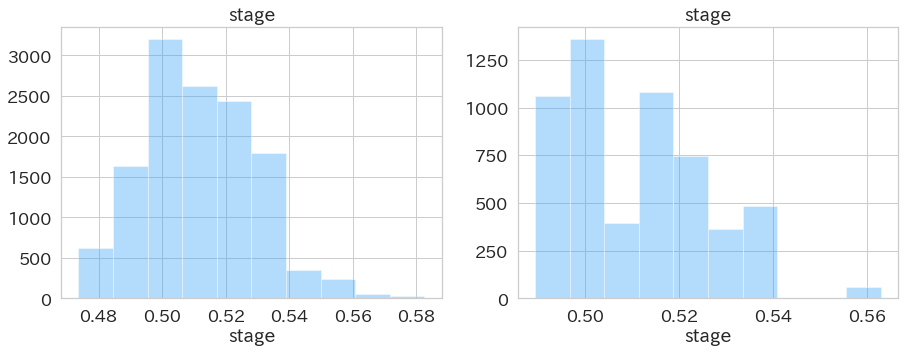

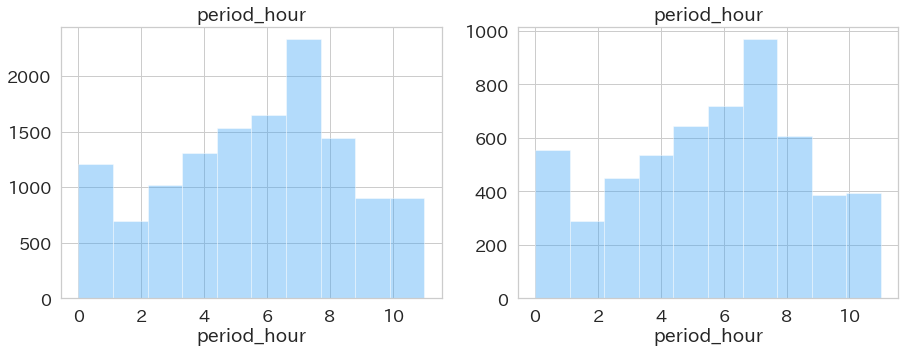

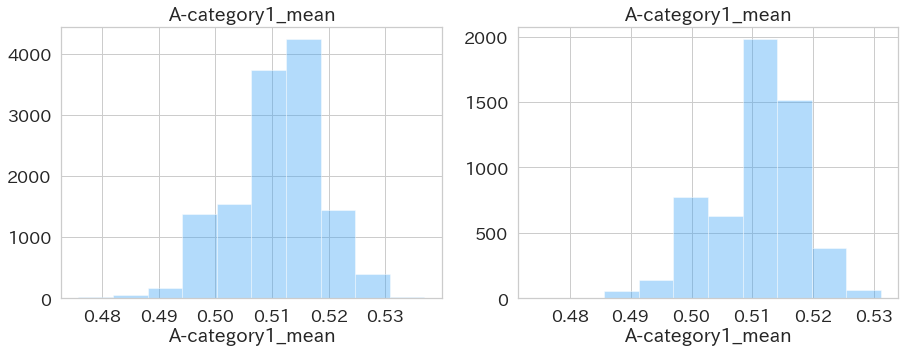

...

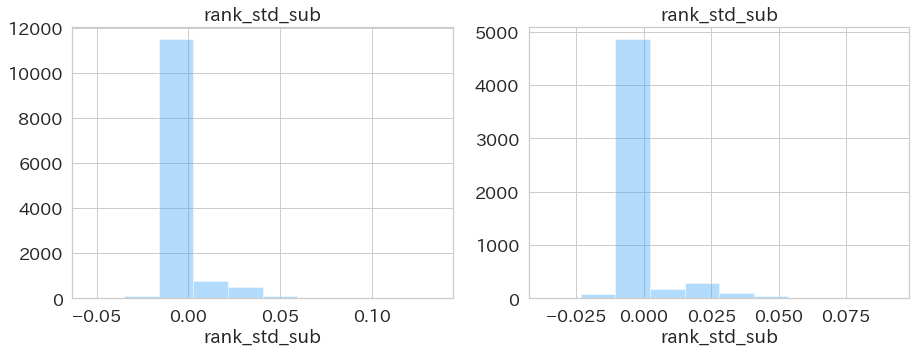

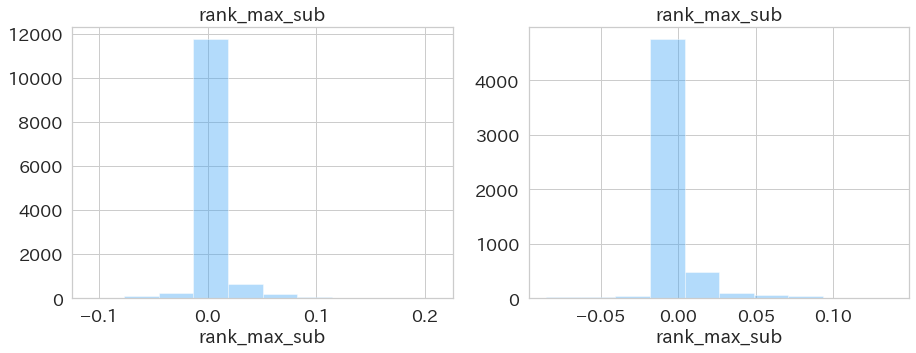

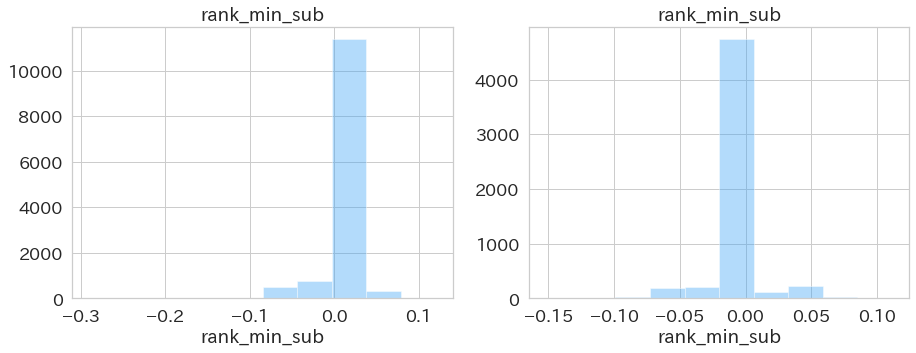

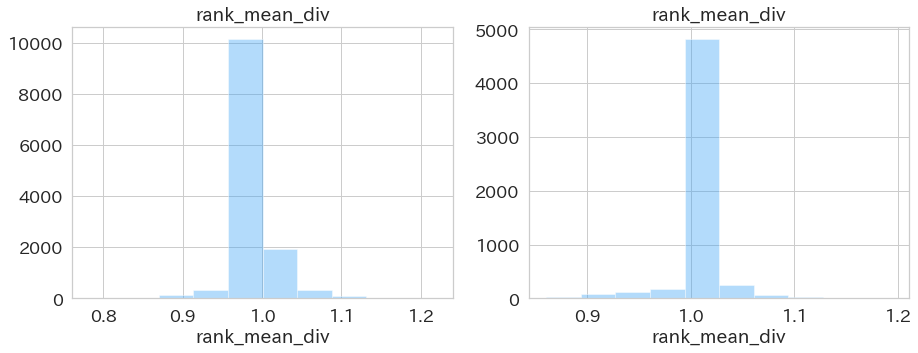

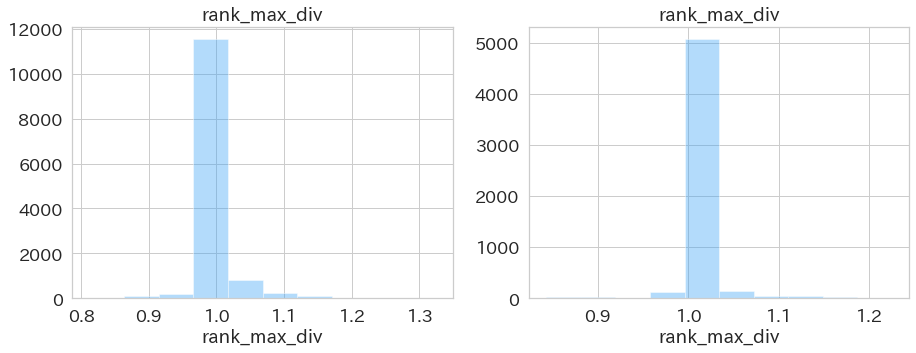

In [56]:
temp = pd.read_csv("case05_multiple_yagura.csv")
for c in temp.columns:
    if c == "y" or c == "id" or c == "reskin_min_div" or c == "rank_std_div" or c == "rank_min_div": continue
        
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    sns.distplot(temp.dropna(subset=["y"])[c], bins=10, kde=False, ax=ax[0])
    ax[0].set_title(c)
    sns.distplot(temp[temp["y"].isnull()][c], bins=10, kde=False, ax=ax[1])
    ax[1].set_title(c)
    plt.show()

In [49]:
temp[temp["y"].isnull()]["A-rank_std"].value_counts().sort_index(), temp[temp["y"].isnull()]["B-rank_std"].value_counts().sort_index()

(0.000000       1
 0.000130    3575
 0.000182     622
 0.000327    1363
 0.007141      10
             ... 
 0.234589       1
 0.247436       1
 0.260820       1
 0.275780       1
 0.323845       1
 Name: A-rank_std, Length: 157, dtype: int64,
 0.000000       5
 0.000230    3573
 0.000363     622
 0.000397    1361
 0.003169       5
             ... 
 0.104167       1
 0.118876       2
 0.139723       1
 0.140106       1
 0.162893       1
 Name: B-rank_std, Length: 164, dtype: int64)

In [50]:
temp[temp["y"].isnull()]["rank_std_div"].value_counts().sort_index(), temp.dropna(subset=["y"])["rank_std_div"].value_counts().sort_index()

(0.000000    1
 0.209392    1
 0.212646    1
 0.217257    1
 0.232891    1
            ..
 7.159743    1
 7.781702    1
 7.827274    2
 7.833587    1
 inf         5
 Name: rank_std_div, Length: 665, dtype: int64,
 0.000000     293
 0.092645       1
 0.117793       1
 0.157030       1
 0.178045       1
             ... 
 7.635358       1
 9.434354       1
 10.824586      1
 12.972635      1
 inf           20
 Name: rank_std_div, Length: 1780, dtype: int64)